# Computer Vision 2024 Assignment 1: Image filtering.

In this prac you will research, implement and test some image filtering operations. Image filtering by convolution is a fundamental step in many computer vision tasks and you will find it useful to have a firm grasp of how it works. For example, later in the course we will come across Convolutional Neural Networks (CNNs) which are built from convolutional image filters.

The main aims of the prac are:

- to understand the basics of how images are stored and processed in memory;
- to gain exposure to several common image filters, and understand how they work;
- to get practical experience implementing convolutional image filters;
- to test your intuition about image filtering by running some experiments;
- to report your results in a clear and concise manner.

*This assignment relates to the following ACS CBOK areas: abstraction, design, hardware and software, data and information, HCI and programming.*

## General instructions

Follow the instructions in this Python notebook and the accompanying file *a1code.py* to answer each question. It's your responsibility to make sure your answer to each question is clearly labelled and easy to understand. Note that most questions require some combination of Python code, graphical output, and text analysing or describing your results. Although we will check your code as needed, marks will be assigned based on the quality of your write up rather than for code correctness! This is not a programming test - we are more interested in your understanding of the topic.

Only a small amount of code is required to answer each question. We will make extensive use of the Python libraries

- [numpy](numpy.org) for mathematical functions
- [skimage](https://scikit-image.org) for image loading and processing
- [matplotlib](https://matplotlib.org/stable/index.html) for displaying graphical results
- [jupyter](https://jupyter.org) for Jupyter Notebooks

You should get familiar with the documentation for these libraries so that you can use them effectively.

# The Questions

To get started, below is some setup code to import the libraries we need. You should not need to edit it.

In [1]:
# Numpy is the main package for scientific computing with Python. 
import numpy as np

#from skimage import io

# Imports all the methods we define in the file a1code.py
from a1code import *

# Matplotlib is a useful plotting library for python 
import matplotlib.pyplot as plt
# This code is to make matplotlib figures appear inline in the
# notebook rather than in a new window.
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

## Question 0: Numpy warm up! (5%)

Before starting the assignment, make sure you have a working Python 3 installation, with up to date versions of the libraries mentioned above. If this is all new to you, I'd suggest  downloading an all in one Python installation such as [Anaconda](https://www.anaconda.com/products/individual). Alternatively you can use a Python package manager such as pip or conda, to get the libraries you need. If you're struggling with this please ask a question on the MyUni discussion forum.

For this assignment, you need some familiarity with numpy syntax. The numpy QuickStart should be enough to get you started:

https://numpy.org/doc/stable/user/quickstart.html

Here are a few warm up exercises to make sure you understand the basics. Answer them in the space below. Be sure to print the output of each question so we can see it!

1. Create a 1D numpy array Z with 12 elements. Fill with values 1 to 12.
2. Reshape Z into a 2D numpy array A with 3 rows and 4 columns.
3. Reshape Z into a 2D numpy array B with 4 rows and 3 columns.
4. Calculate the *matrix* product of A and B.
5. Calculate the *element wise* product of $A$ and $B^T$ (B transpose).


In [2]:
# 1
Z = np.arange(1,13,1)
print("1: ")
print(Z)

# 2 
A = Z.reshape((3,4))
print("2: ")
print(A)

# 3 
B = Z.reshape((4,3))
print("3: ")
print(B)

# 4
print("4: ")
print(np.matmul(A,B))

# 5
print("5: ")
print(A * B.T)

1: 
[ 1  2  3  4  5  6  7  8  9 10 11 12]
2: 
[[ 1  2  3  4]
 [ 5  6  7  8]
 [ 9 10 11 12]]
3: 
[[ 1  2  3]
 [ 4  5  6]
 [ 7  8  9]
 [10 11 12]]
4: 
[[ 70  80  90]
 [158 184 210]
 [246 288 330]]
5: 
[[  1   8  21  40]
 [ 10  30  56  88]
 [ 27  60  99 144]]


You need to be comfortable with numpy arrays because that is how we store images. Let's do that next!

## Question 1: Loading and displaying an image (10%)

Below is a function to display an image using the pyplot module in matplotlib. Implement the `load()` and `print_stats()` functions in a1code.py so that the following code loads the mandrill image, displays it and prints its height, width and channel. 

In [3]:
def display(img, caption='', **args):
    # Show image using pyplot 
    plt.figure()
    plt.imshow(img, **args)
    plt.title(caption)
    plt.axis('off')
    plt.show()

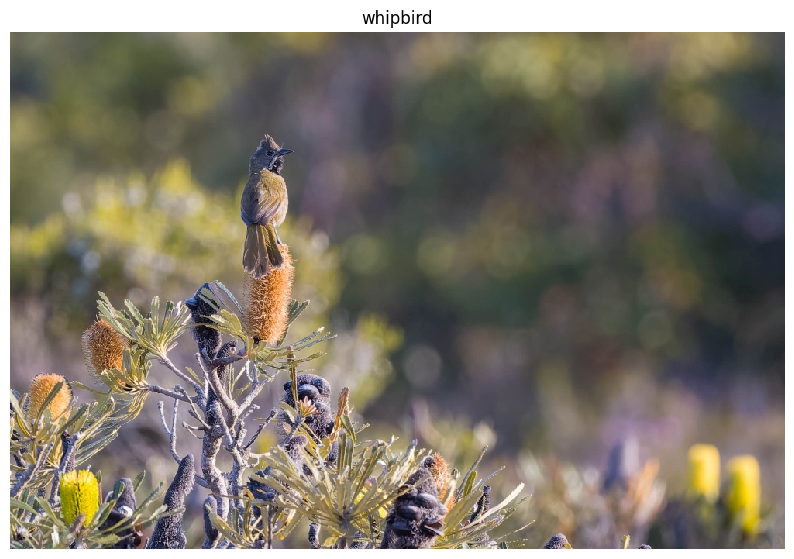

Width: 667
Height: 1000
channels: 3


In [4]:
image1 = load('images/whipbird.jpg')
display(image1, 'whipbird')
print_stats(image1)

Implement the `load()` and `print_stats()` functions in a1code.py so that the following code loads the mandrill image, displays it and prints its height, width and channel. 

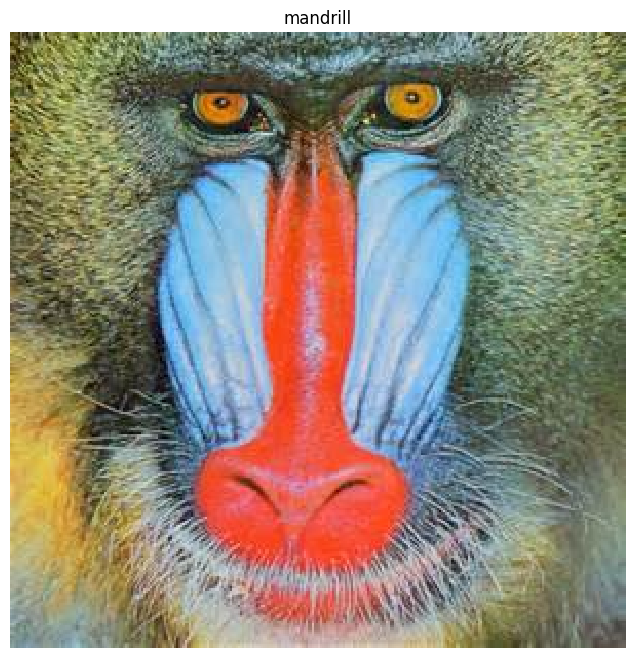

Width: 300
Height: 300
channels: 3


In [5]:
image_mandrill = load('images/mandrill.jpg')
display(image_mandrill, 'mandrill')
print_stats(image_mandrill)

What happens when a processed pixel value becomes < 0 or > 255, and what effect does this have on later processing?


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.5].


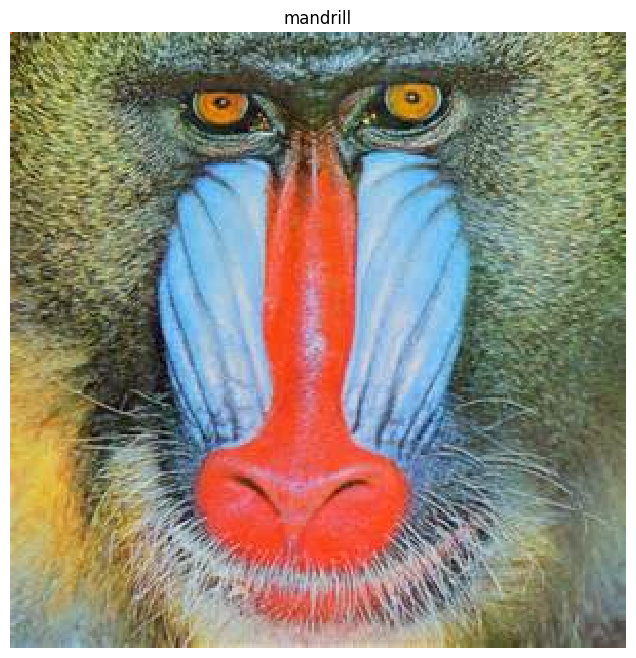

In [6]:
# We manullay set or process image to be outside the allowable range
image_mandrill[0,0,0] = 1.5
display(image_mandrill, 'mandrill')

We see that the skimage library clips that matrix to be set into the allowable range. This shows that images outside the range will be constrained within the [0, 255] or the range [0.0, 1.0]. Normally, the value from 0 to 255 indicates a color being off completely to being on completely respectively as the pixel gets colors from completely black to completey white (depending on the color channel). However, even if the displayed image shows the pixel values in range, the actual value inside the matrix will outside the allowable constraints. This can mess up some computations later on, and it might help to normalize or clip the values in the point processing functions.

Repeat the above for a RGB test image, but this time, apply the point process only to one channel of the image (red, green or blue). Display the resulting RGB image.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5..1.0].


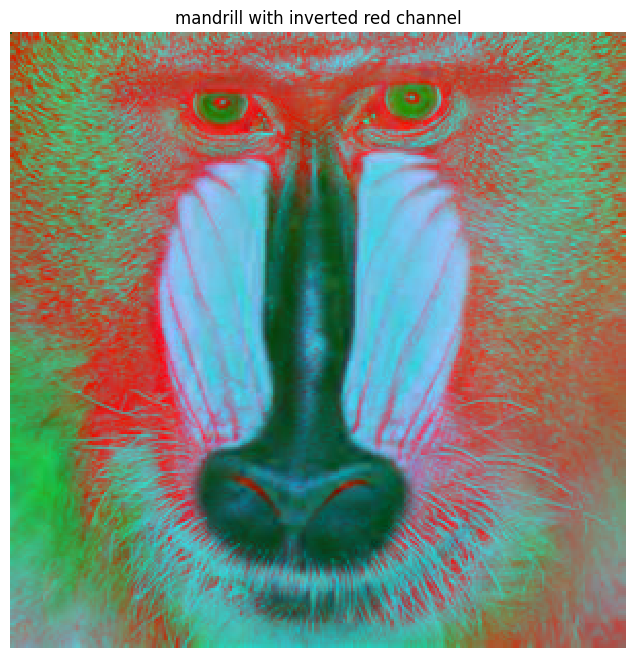

In [7]:
# We will invert the channel values for the first channel (R)
mandrill_inverted_red = np.copy(image_mandrill)
mandrill_inverted_red[:,:,0] = 1 - mandrill_inverted_red[:,:,0]
display(mandrill_inverted_red, 'mandrill with inverted red channel')

Return to this question after reading through the rest of the assignment. Find 2 more images to use as test cases in this assignment for all the following questions and display them below. Use your `print_stats()` function to display their height, width and number of channels. Explain *why* you have chosen each image.

In [8]:
### Your code to load and display your images here
image_gradient = load("./images/gradient_.jpeg")
image_BW = load("./images/BW.jpg")
flower = load("./images/flower.jpeg")

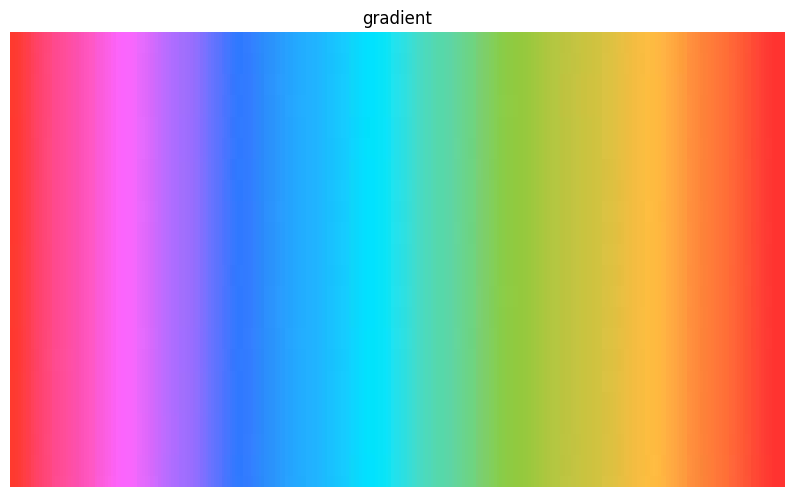

Width: 172
Height: 293
channels: 3


In [9]:
display(image_gradient, "gradient")
print_stats(image_gradient)

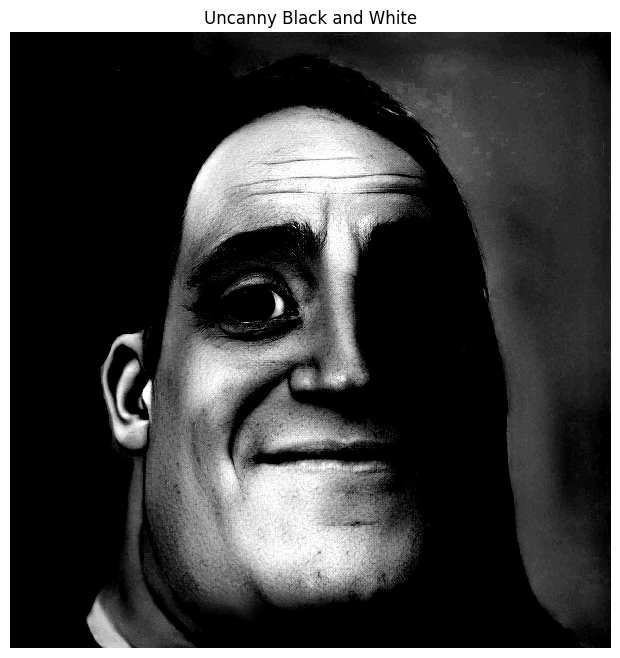

Width: 1911
Height: 1864
channels: 3


In [10]:
display(image_BW, "Uncanny Black and White")
print_stats(image_BW)

The image I chose is greyscahel (black-and-white) has a wide range or black and white values. Additionally, it has some aliasing present in some image artifacting as seen in the upper right. Lastly, we can see how the distinct edge between the black and white color at the edge around the righter area.

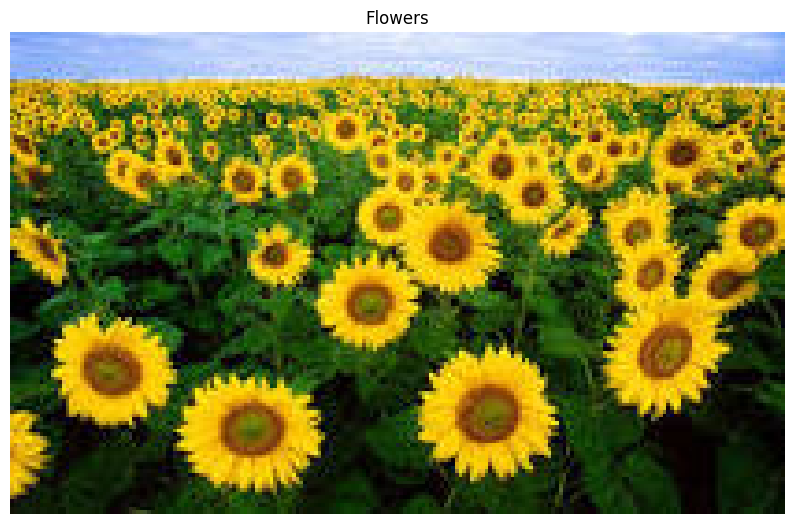

Width: 130
Height: 209
channels: 3


In [11]:
display(flower, "Flowers")
print_stats(flower)

**Explanation of Images**:
1. The first image contains the full range of RBG values. The focus of this would be to see the effect of pixel manipulation on the entire scale of the RBG. Additionally, image shows blending of the values in a manner that appears to be continuous. Seeing the impact of manipulating image resolution will also be evident in this image.

2. The second image is predominantly greyscaled with only black-and-white as the available colors. Moreover, this image was chosen given distinct contrasts and difference of brightness on the certain sections of the picture which aims to demonstrate edge detection. Compared to the other pictures as well, this image has a higher pixel count (or pixel density as a consequence) which also aims to show the impact of resizing on a high resolution image.

3. The third image was chosen due to having some colors that are predominantly present compared to other colors. Contrasting to the other picture above, this image aims to show the effects of image processing on a relatively smaller image. This can be used to demonstrate the effects of image processing on images that are more predisposed to a specific color channel. 

## Question 2: Image processing (25%)

Now that you have an image stored as a numpy array, let's try some operations on it.

1. Implement the `crop()` function in a1code.py. Use array slicing to crop the image.
2. Implement the `resize()` function in a1code.py.
3. Implement the `change_contrast()` function in a1code.py.
4. Implement the `greyscale()` function in a1code.py.
5. Implement the `binary()` function in a1code.py.

What do you observe when you change the threshold of the binary function?

Apply all these functions with different parameters on your own test images.

Whipbird Image
----------------------------------


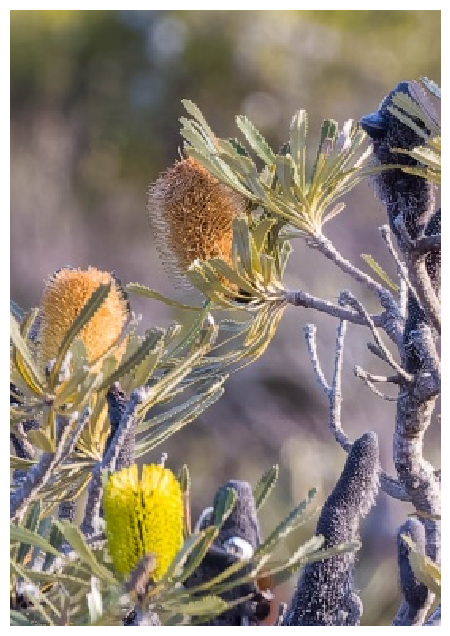

Width: 389
Height: 272
channels: 3


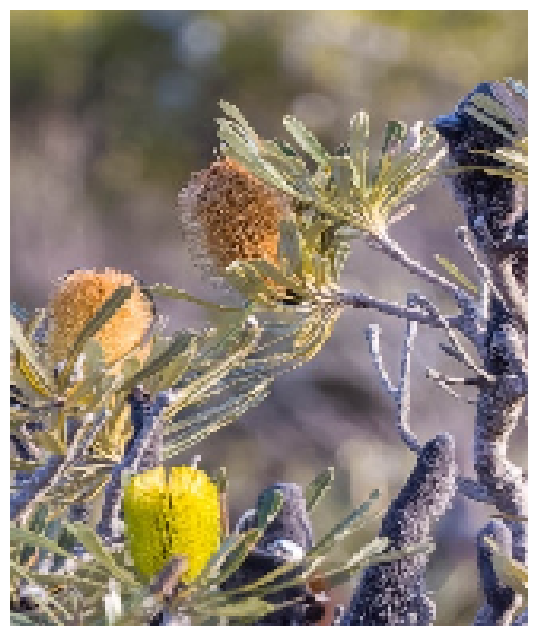

Width: 194
Height: 163
channels: 3


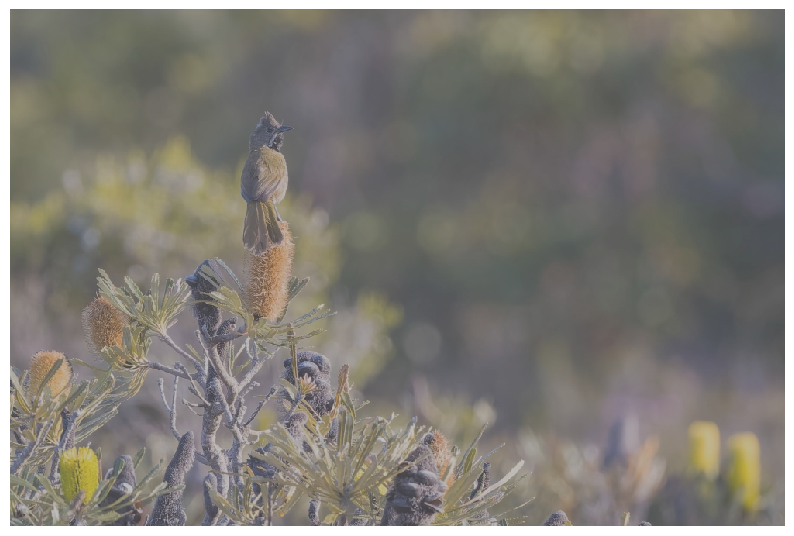

Width: 667
Height: 1000
channels: 3


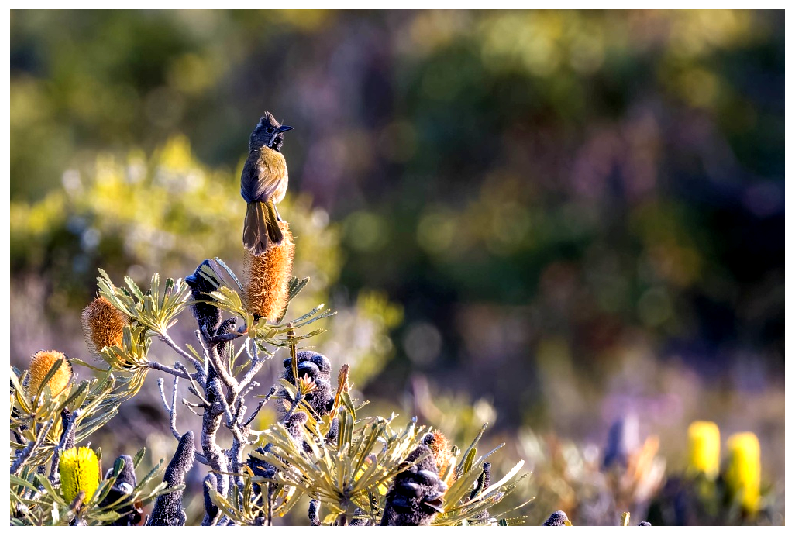

Width: 667
Height: 1000
channels: 3


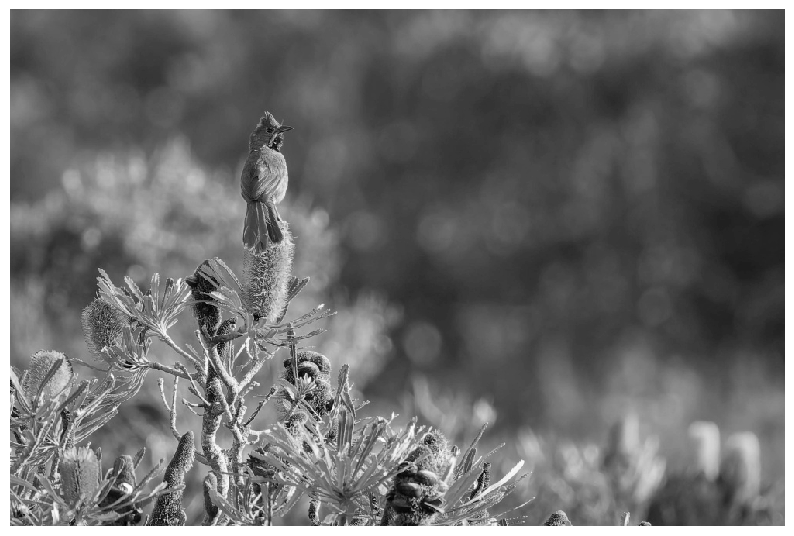

Width: 667
Height: 1000
channels: 1


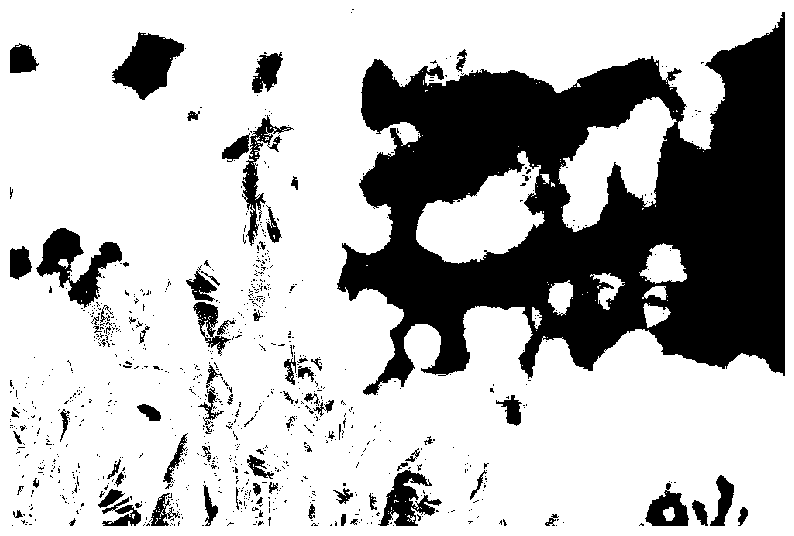

Width: 667
Height: 1000
channels: 1


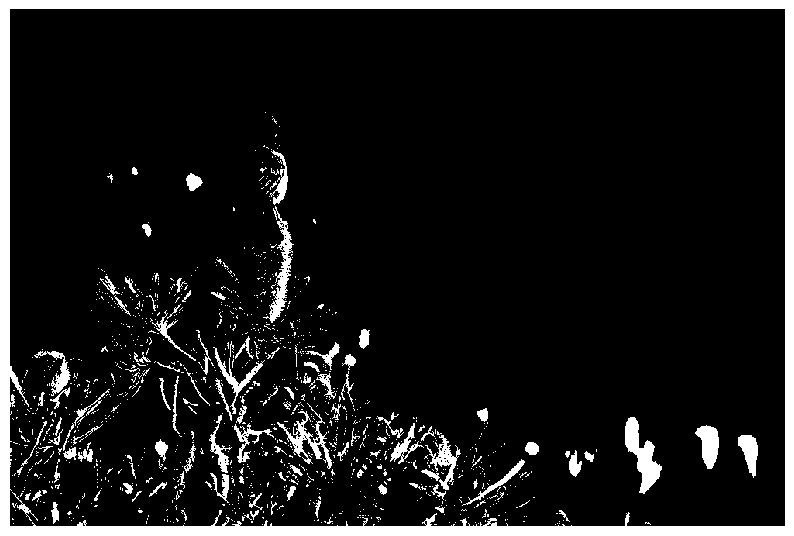

Width: 667
Height: 1000
channels: 1


In [12]:
# This should crop the bird from the  image; you will need to adjust the parameters for the correct crop size and location 
print('Whipbird Image')
print('----------------------------------')
crop_img = crop(image1, 278, 5, 508, 272)
display(crop_img) 
print_stats(crop_img)

resize_img = resize(crop_img, 0.5, 0.6 )
display(resize_img)
print_stats(resize_img)

contrast_img = change_contrast(image1, 0.5)
display(contrast_img)
print_stats(contrast_img)

contrast_img = change_contrast(image1, 1.5)
display(contrast_img)
print_stats(contrast_img)

grey_img = greyscale(image1)
display(grey_img)
print_stats(grey_img)

binary_img = binary(grey_img, 0.3)
display(binary_img)
print_stats(binary_img)

binary_img = binary(grey_img, 0.7)
display(binary_img)
print_stats(binary_img)

Black and White Image
----------------------------------


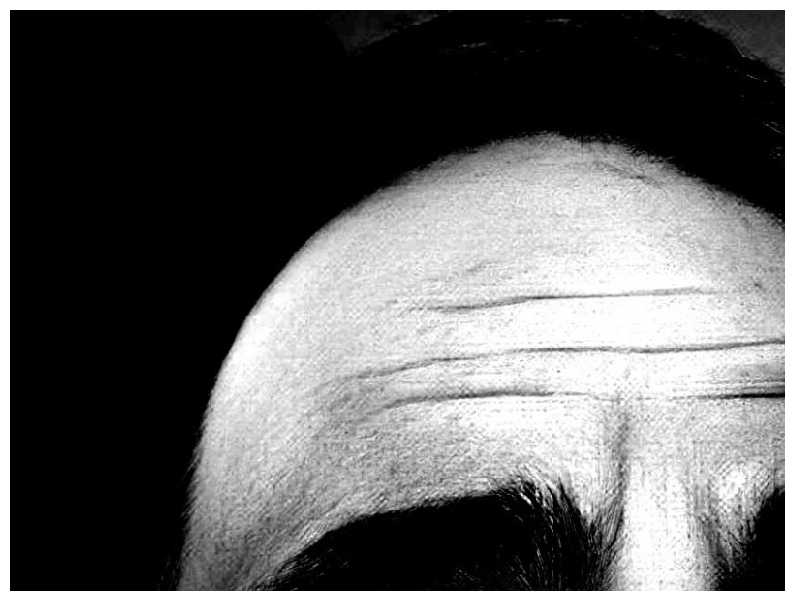

Width: 600
Height: 800
channels: 3


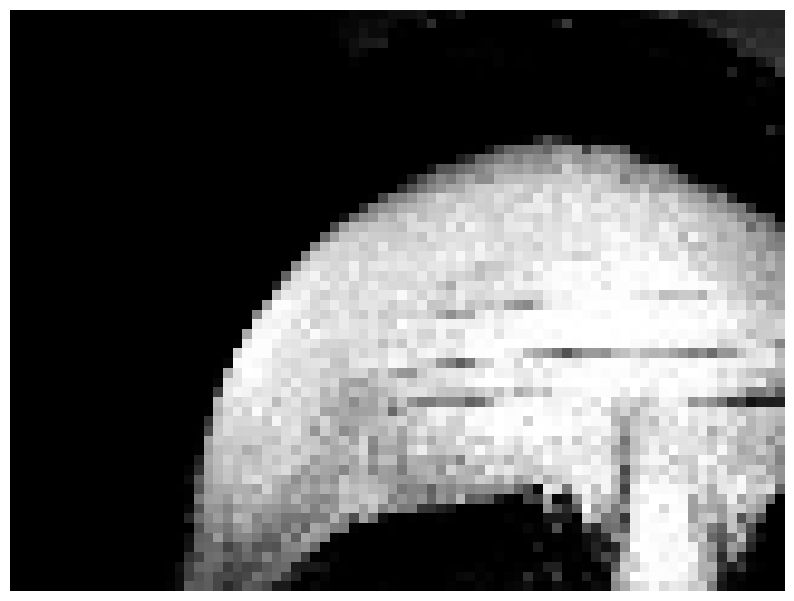

Width: 60
Height: 80
channels: 3


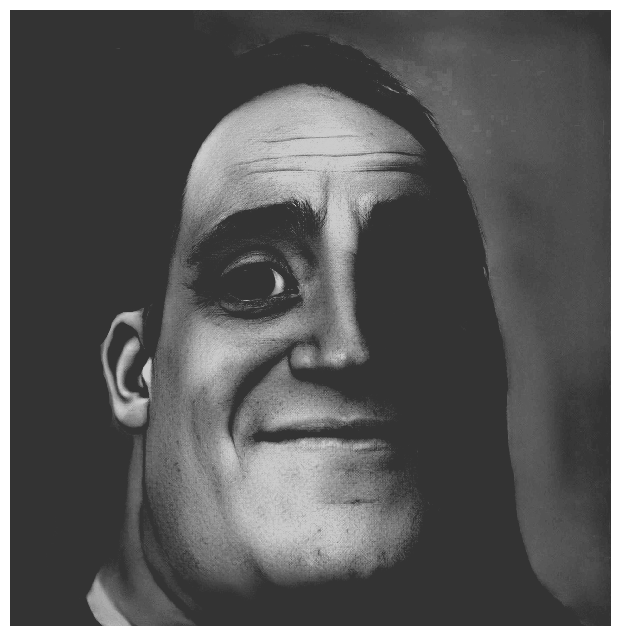

Width: 1911
Height: 1864
channels: 3


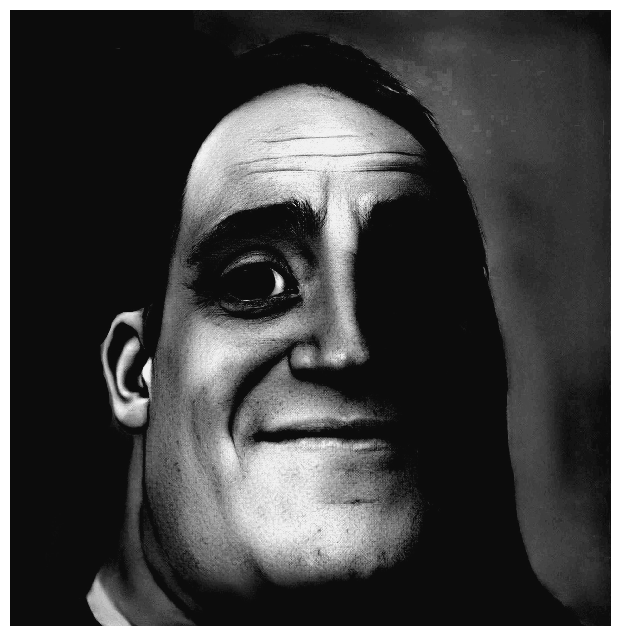

Width: 1911
Height: 1864
channels: 3


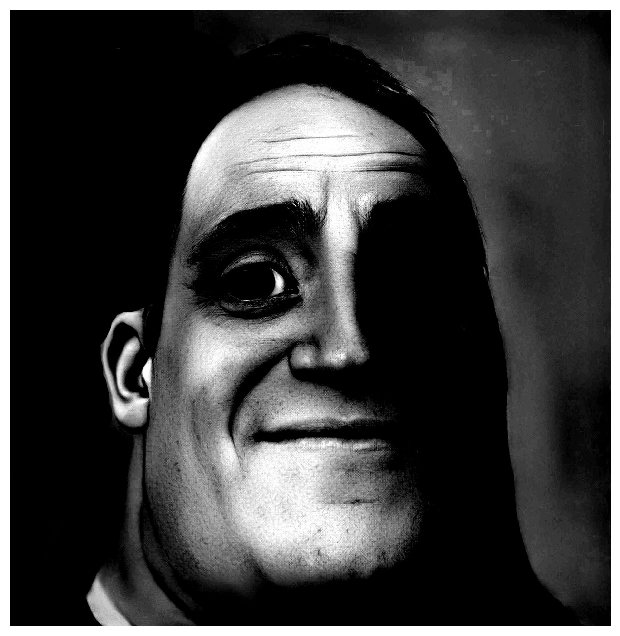

Width: 1911
Height: 1864
channels: 1


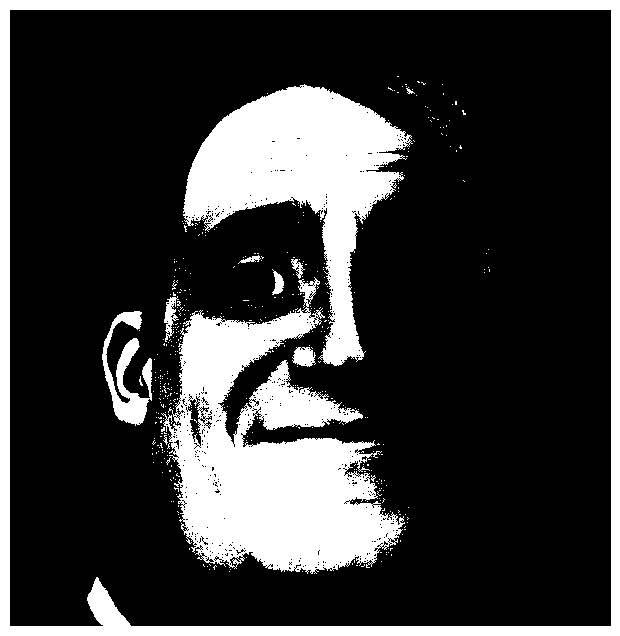

Width: 1911
Height: 1864
channels: 1


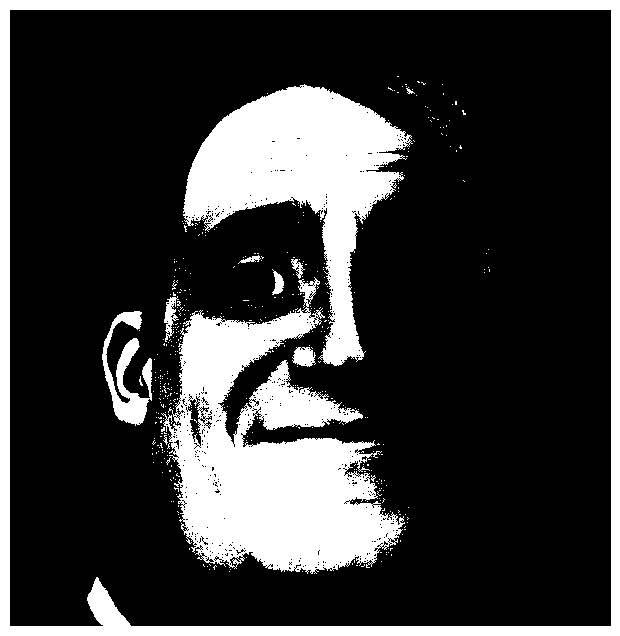

Width: 1911
Height: 1864
channels: 1
Gradient Image
----------------------------------


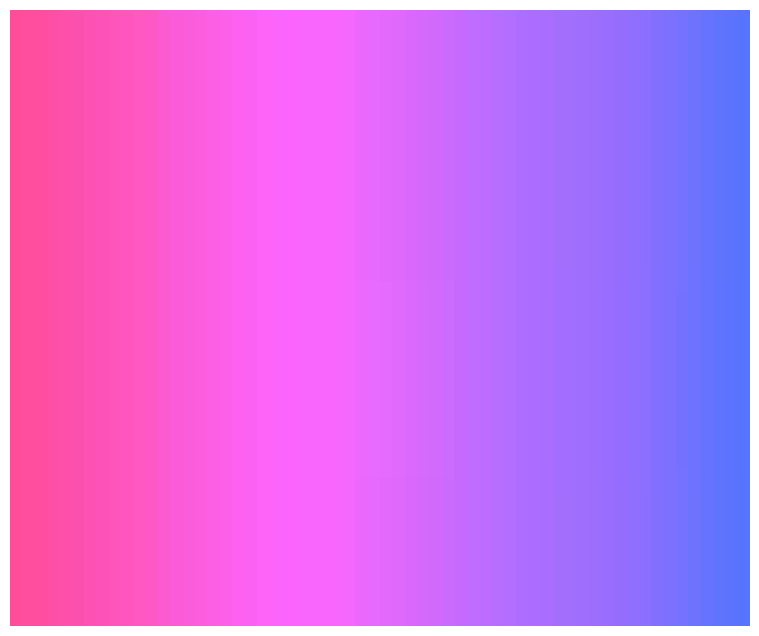

Width: 50
Height: 60
channels: 3


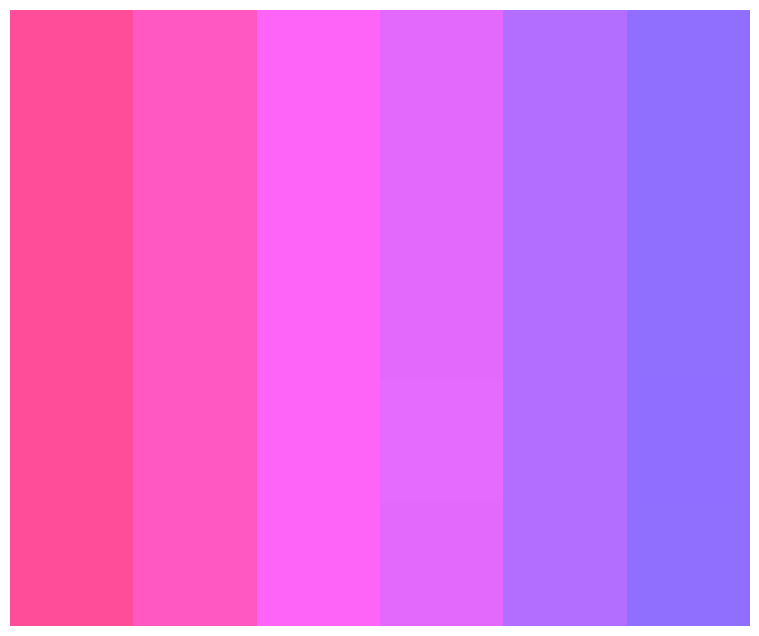

Width: 5
Height: 6
channels: 3


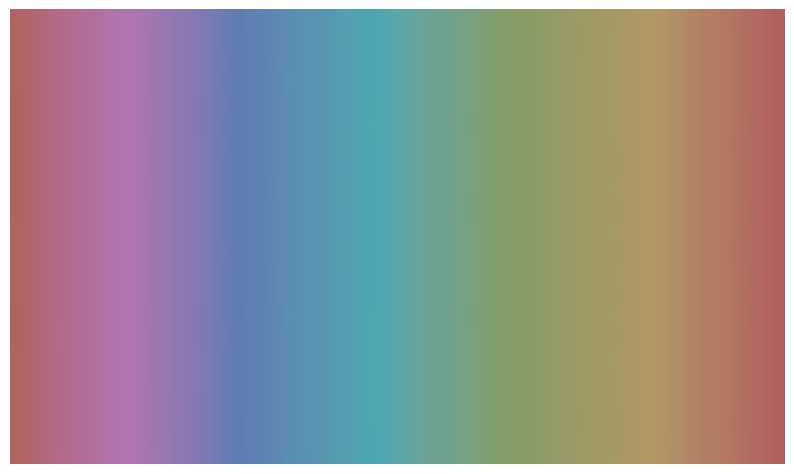

Width: 172
Height: 293
channels: 3


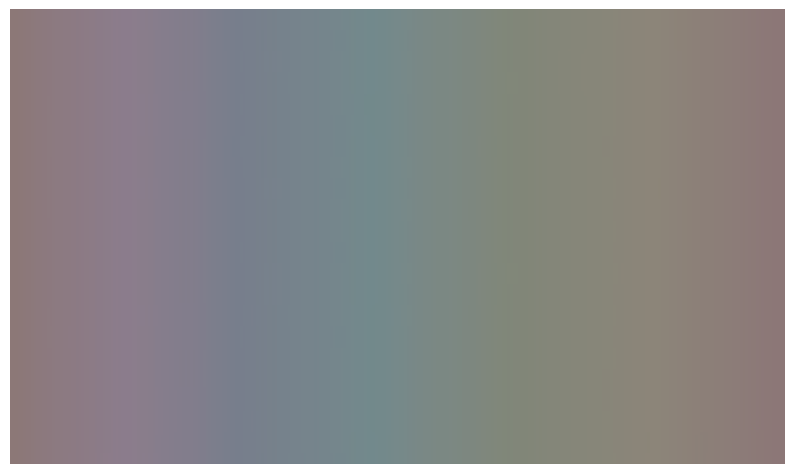

Width: 172
Height: 293
channels: 3


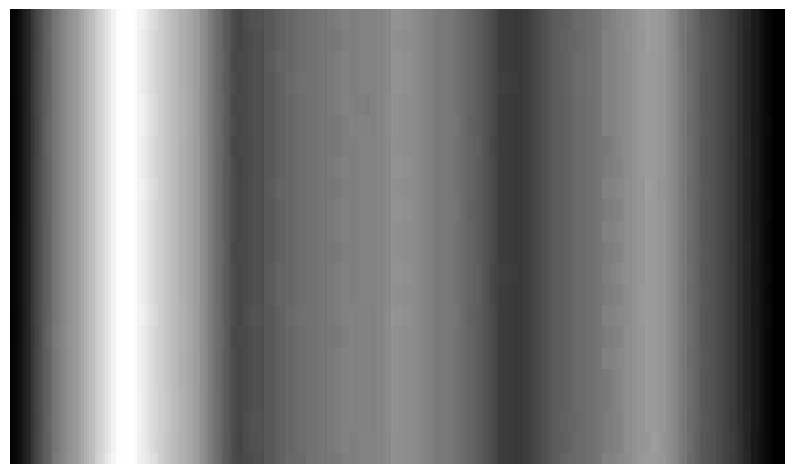

Width: 172
Height: 293
channels: 1


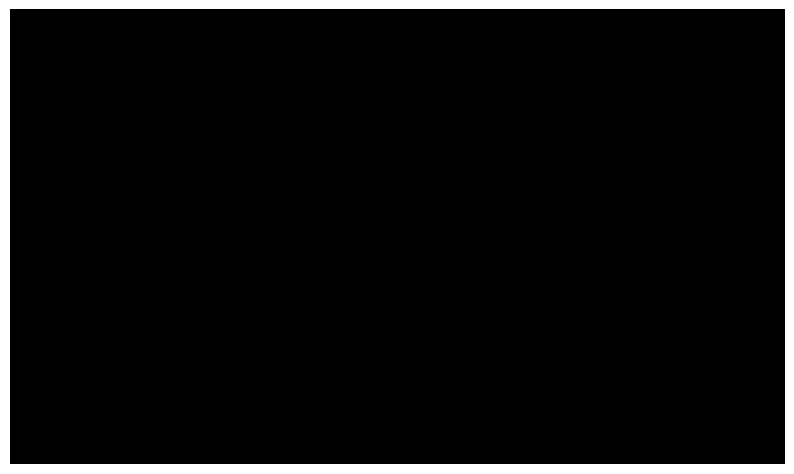

Width: 172
Height: 293
channels: 1


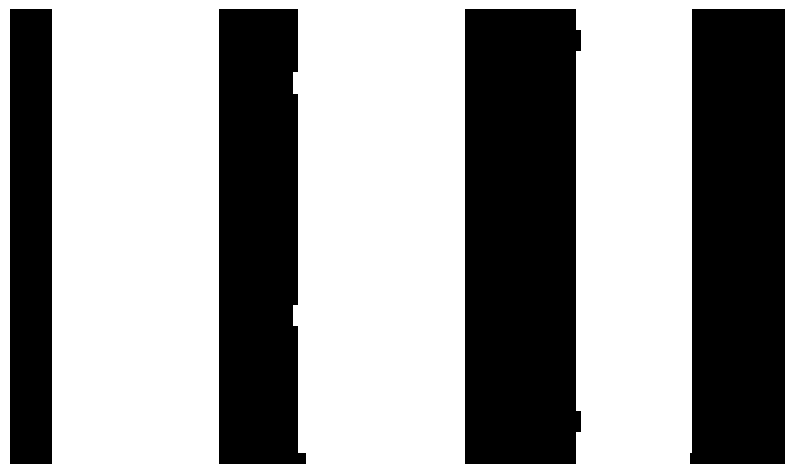

Width: 172
Height: 293
channels: 1
Flower Image
----------------------------------


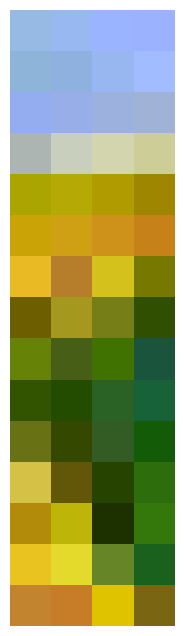

Width: 15
Height: 4
channels: 3


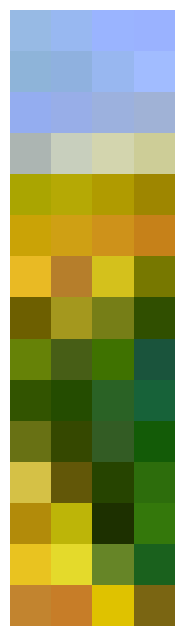

Width: 45
Height: 12
channels: 3


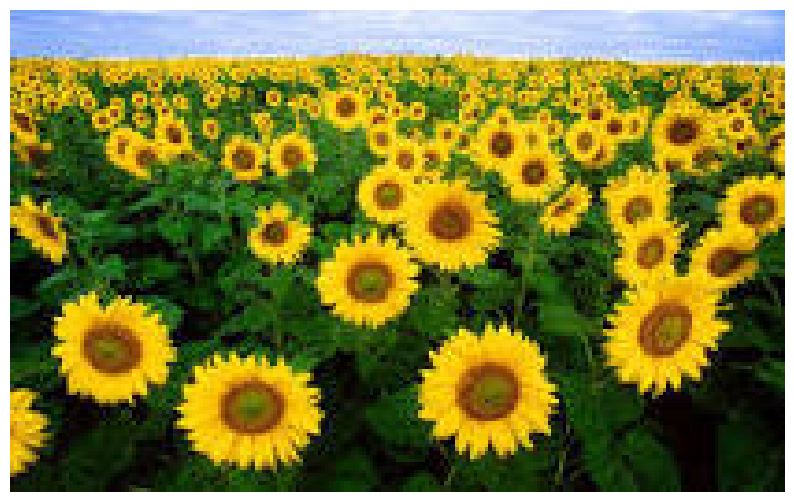

Width: 390
Height: 627
channels: 3


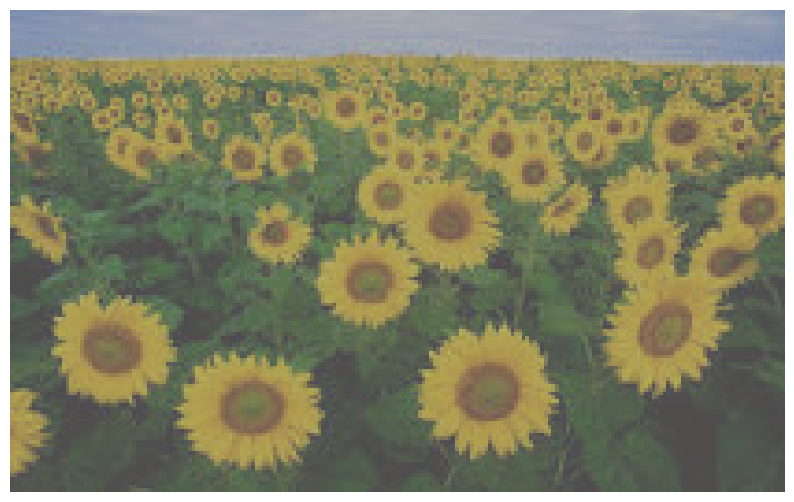

Width: 390
Height: 627
channels: 3


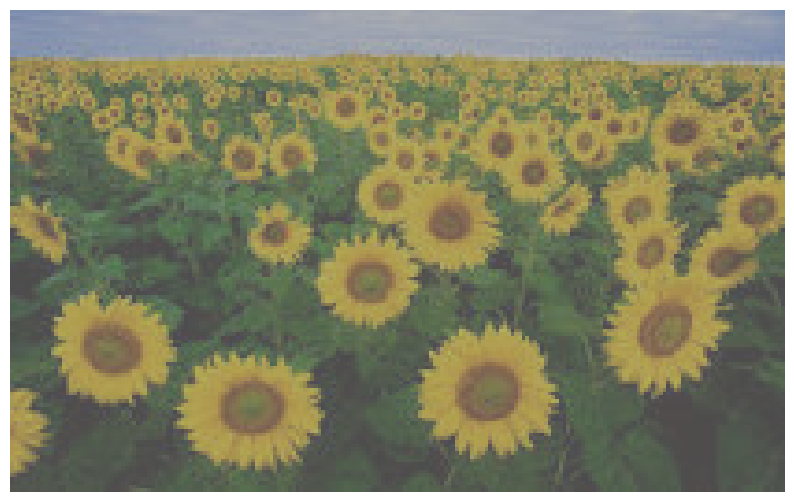

Width: 130
Height: 209
channels: 3


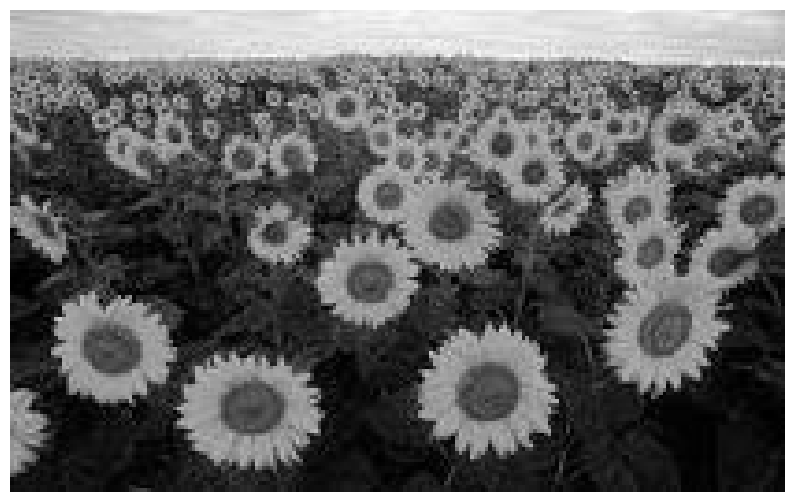

Width: 130
Height: 209
channels: 1


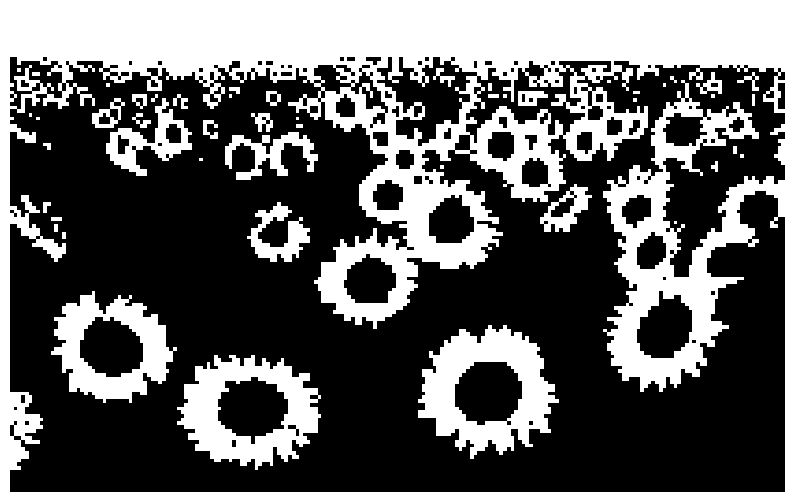

Width: 130
Height: 209
channels: 1


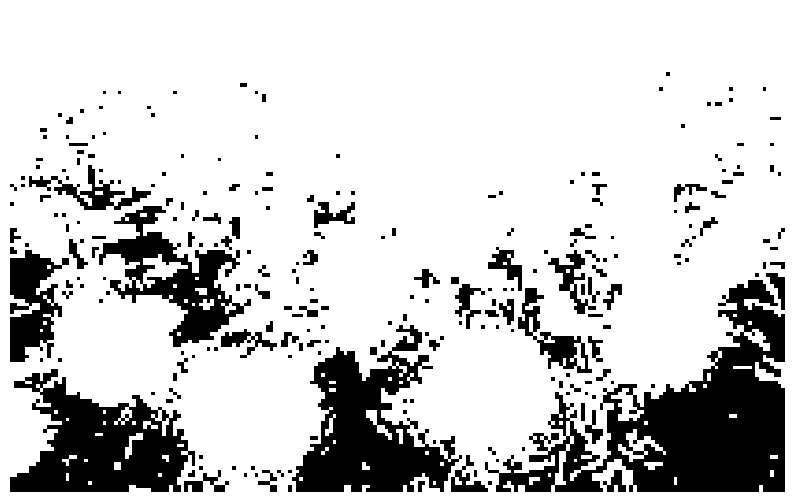

Width: 130
Height: 209
channels: 1


In [13]:
# Add your own tests here...
print('Black and White Image')
print('----------------------------------')
# crop()
crop_BW = crop(image_BW, 100, 350, 600, 800)
display(crop_BW) 
print_stats(crop_BW)

resize_BW = resize(crop_BW, 0.1, 0.1)
display(resize_BW)
print_stats(resize_BW)

contrast_BW = change_contrast(image_BW, 0.6)
display(contrast_BW)
print_stats(contrast_BW)

contrast_BW = change_contrast(image_BW, 0.9)
display(contrast_BW)
print_stats(contrast_BW)

grey_BW = greyscale(image_BW)
display(grey_BW)
print_stats(grey_BW)

binary_BW = binary(grey_BW, 0.4)
display(binary_BW)
print_stats(binary_BW)

binary_WB = binary(grey_BW, 0.7)
display(binary_BW)
print_stats(binary_BW)


print('Gradient Image')
print('----------------------------------')
crop_gradient = crop(image_gradient, 10, 20, 50, 60)
display(crop_gradient) 
print_stats(crop_gradient)

resize_gradient = resize(crop_gradient, 0.1, 0.1)
display(resize_gradient)
print_stats(resize_gradient)

contrast_gradient = change_contrast(image_gradient, 0.4)
display(contrast_gradient)
print_stats(contrast_gradient)

contrast_gradient = change_contrast(image_gradient, 0.1)
display(contrast_gradient)
print_stats(contrast_gradient)

grey_gradient = greyscale(image_gradient)
display(grey_gradient)
print_stats(grey_gradient)

binary_gradient = binary(grey_gradient, 0.1)
display(binary_gradient)
print_stats(binary_gradient)

binary_gradient = binary(grey_gradient, 0.6)
display(binary_gradient)
print_stats(binary_gradient)

print('Flower Image')
print('----------------------------------')
crop_flower = crop(flower, 10, 20, 15, 4)
display(crop_flower) 
print_stats(crop_flower)

resize_flower = resize(crop_flower, 3, 3)
display(resize_flower)
print_stats(resize_flower)

resize_flower = resize(flower, 3, 3)
display(resize_flower)
print_stats(resize_flower)

contrast_flower = change_contrast(resize_flower, 0.4)
display(contrast_flower)
print_stats(contrast_flower)

contrast_flower = change_contrast(flower, 0.4)
display(contrast_flower)
print_stats(contrast_flower)

grey_gradient = greyscale(flower)
display(grey_gradient)
print_stats(grey_gradient)

binary_gradient = binary(grey_gradient, 0.5)
display(binary_gradient)
print_stats(binary_gradient)

binary_gradient = binary(grey_gradient, 0.1)
display(binary_gradient)
print_stats(binary_gradient)

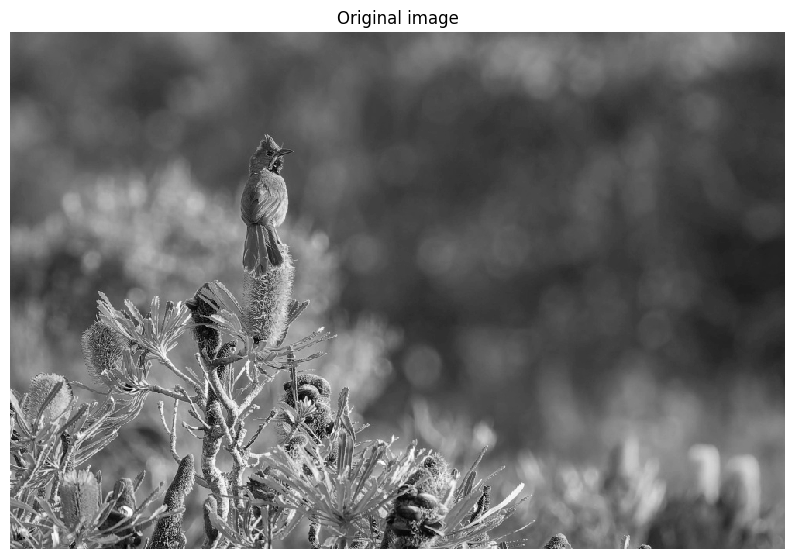

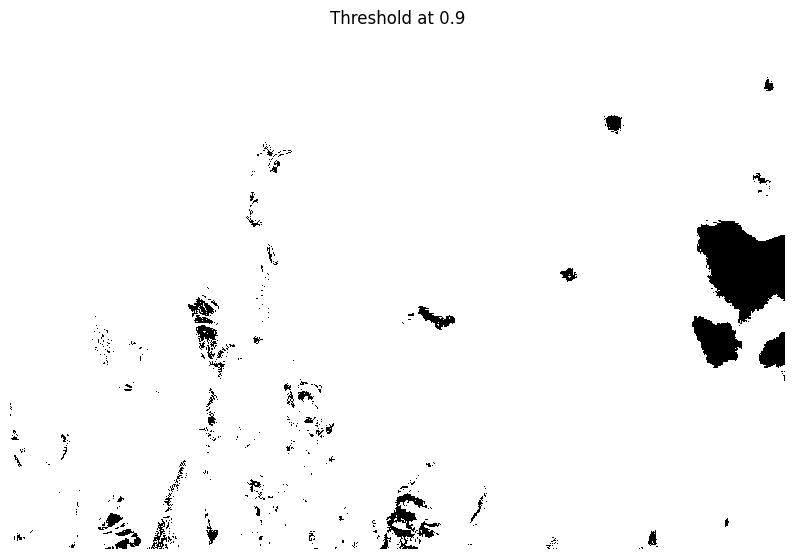

Width: 667
Height: 1000
channels: 1


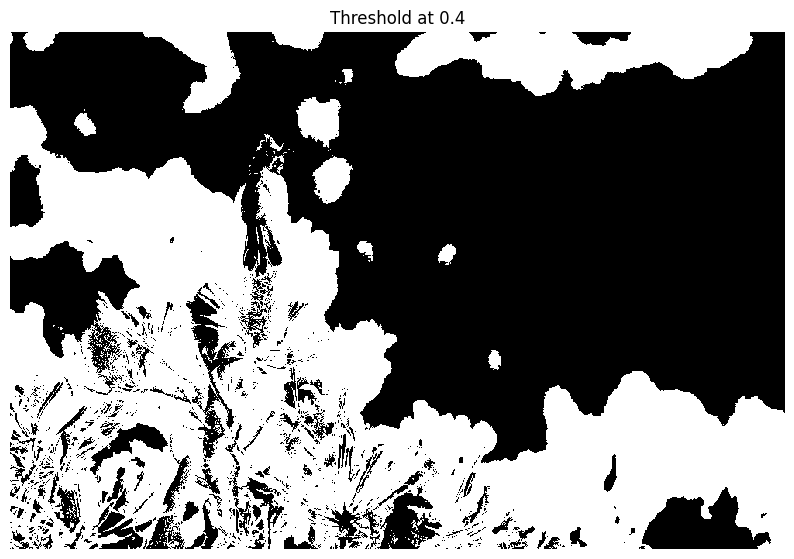

Width: 667
Height: 1000
channels: 1


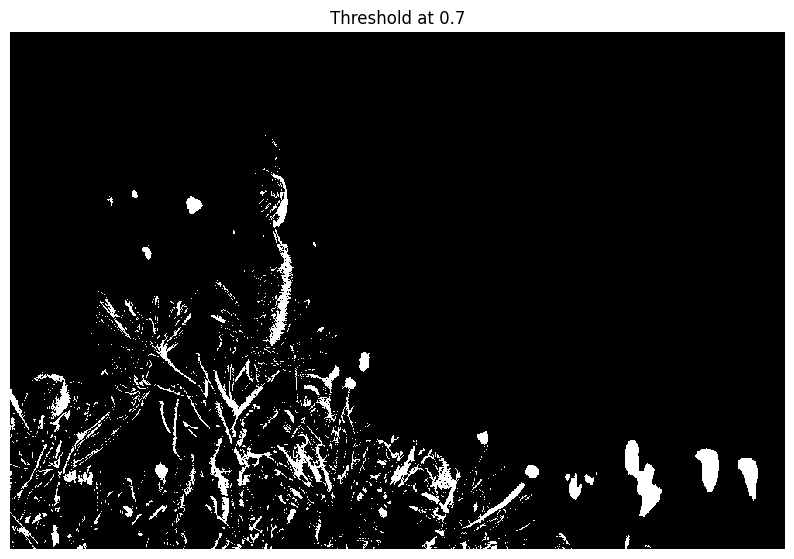

Width: 667
Height: 1000
channels: 1


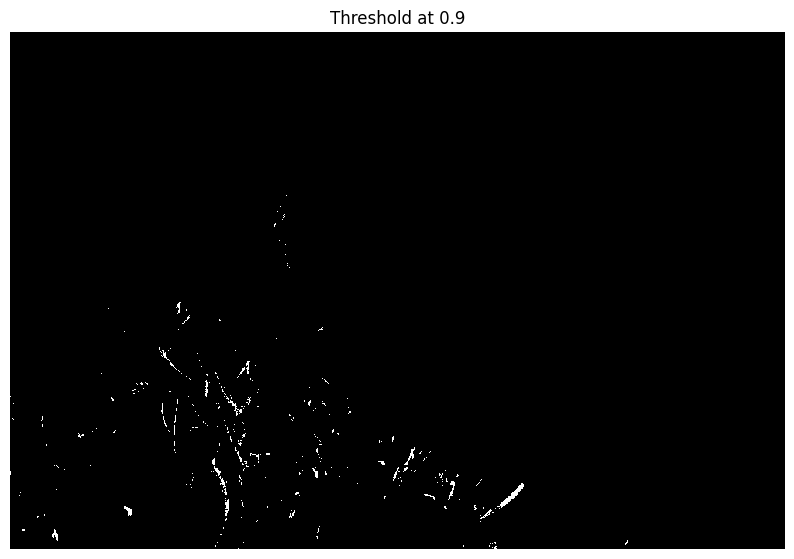

Width: 667
Height: 1000
channels: 1


In [14]:
## We will observe the changes that will occur for the binary function given multiple tresholds
display(grey_img, "Original image")

binary_img = binary(grey_img, 0.2)
display(binary_img, "Threshold at 0.9")
print_stats(binary_img)

binary_img = binary(grey_img, 0.4)
display(binary_img, caption="Threshold at 0.4")
print_stats(binary_img)

binary_img = binary(grey_img, 0.7)
display(binary_img, "Threshold at 0.7")
print_stats(binary_img)


binary_img = binary(grey_img, 0.9)
display(binary_img, "Threshold at 0.9")
print_stats(binary_img)

**What do you observe when you change the threshold of the binary function?**

We see that as we increase the threshold closer to the maximum, more values will be turned off (turned to 0). Naturally, this is due to less values being above the threshold given that the RGB values are monotonically increasing from 0 to 255. This means that the threshold would be the cutoff for pixel intensity.

## Question 3: Convolution (25%)

### 3.1 2D convolution

Using the definition of 2D convolution from week 1, implement the convolution operation in the function `conv2D()` in a1code.py.


In [15]:
test_conv2D()

### 3.2 RGB convolution

In the function `conv` in a1code.py, extend your function `conv2D` to work on RGB images, by applying the 2D convolution to each channel independently. 

### 3.3 Gaussian filter convolution

Use the `gauss2D` function provided in a1code.py to create a Gaussian kernel, and apply it to your images with convolution. You will obtain marks for trying different tests and analysing the results, for example:

- try varying the image size, and the size and variance of the filter  
- subtract the filtered image from the original - this gives you an idea of what information is lost when filtering

What do you observe and why?

**Varying image size, size and variance of the filter** 

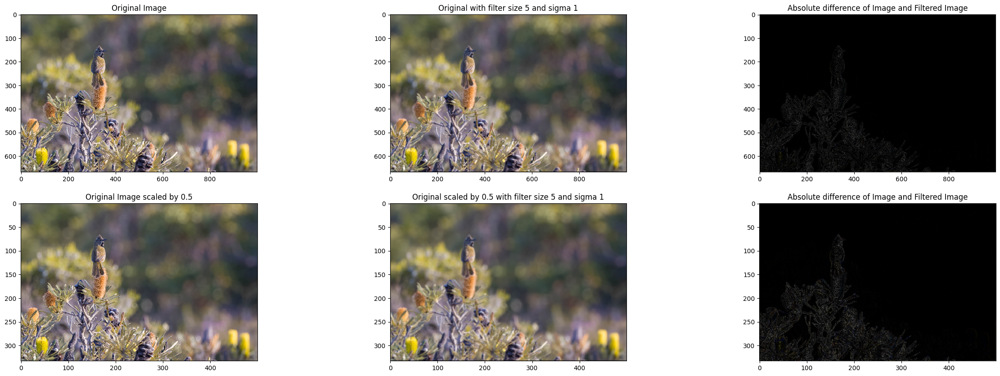

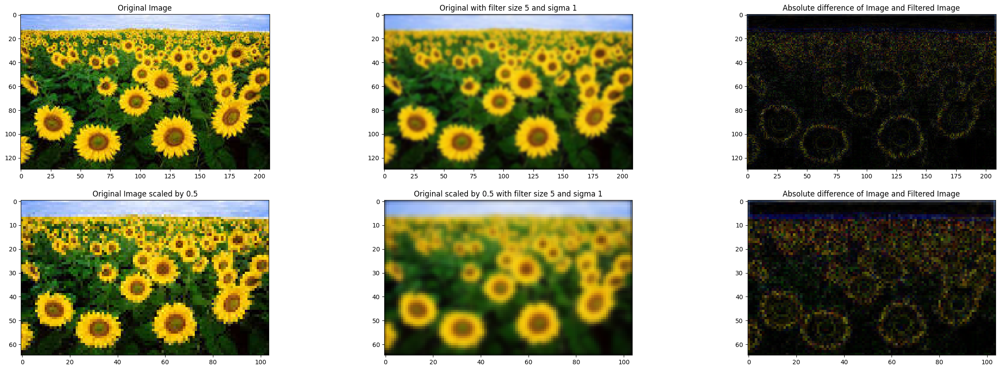

In [16]:
# Varying image sizes 
# Resize image and then apply same the Gaussian filter
def varying_sizes(image, kernel_size: int, sigma: int) -> None:
    fig, axes = plt.subplots(2,3,figsize=(30, 10))
    gauss_filter = gauss2D(kernel_size, sigma)
    # Define a Gaussian Filter
    half_sized = resize(image, 0.5, 0.5)

    axes[0][0].imshow(image)
    axes[0][0].set_title(f'Original Image')

    convolved_image = conv(image, gauss_filter)

    axes[0][1].imshow(convolved_image)
    axes[0][1].set_title(f'Original with filter size {kernel_size} and sigma {sigma}')

    axes[0][2].imshow(abs(image - convolved_image), cmap='gray')
    axes[0][2].set_title(f'Absolute difference of Image and Filtered Image')

    axes[1][0].imshow(half_sized)
    axes[1][0].set_title(f'Original Image scaled by 0.5')

    convolved_image = conv(half_sized, gauss_filter)

    axes[1][1].imshow(convolved_image)
    axes[1][1].set_title(f'Original scaled by 0.5 with filter size {kernel_size} and sigma {sigma}')

    axes[1][2].imshow(abs(half_sized - convolved_image), cmap = 'gray')
    axes[1][2].set_title(f'Absolute difference of Image and Filtered Image') 
    plt.show()

varying_sizes(image1, 5, 1)
varying_sizes(flower, 5, 1)

**Observations with varying sizes and doing the same convolution with the same filter**

It can be observed that when the image is resized to be smaller first, the resulting image is blurred more since more information is lost due when the number of pixels being reduced by a factor. This is most evident in the flower image which already has a relatively small pixel count where we see that the blurred image is significantly less detailed compared to the original image. Additionally, in the whipbird example that the middle bottom picture is less detailed than the top middle picture. This visualized by a brighter absolute difference image to the right on both examples (since brighter pixels mean a greater absolute difference).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.3582785779741045e-07..1.3124333055716075].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.5].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [5.6999517772382546e-08..1.3774474849366587].


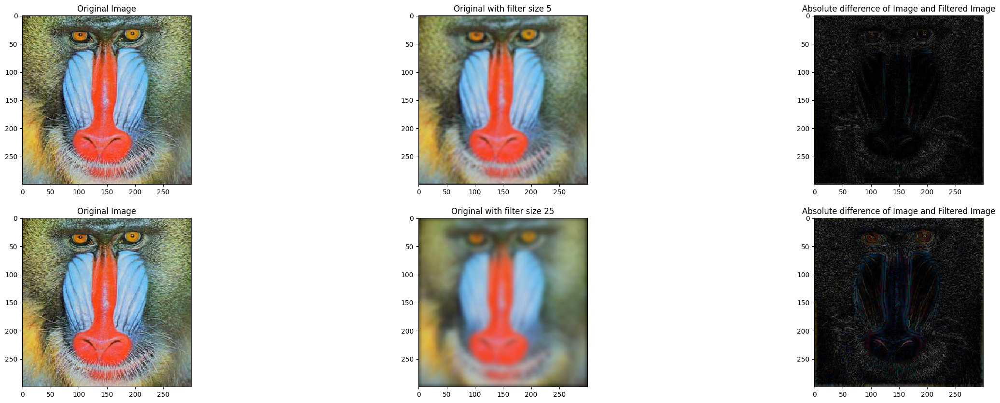

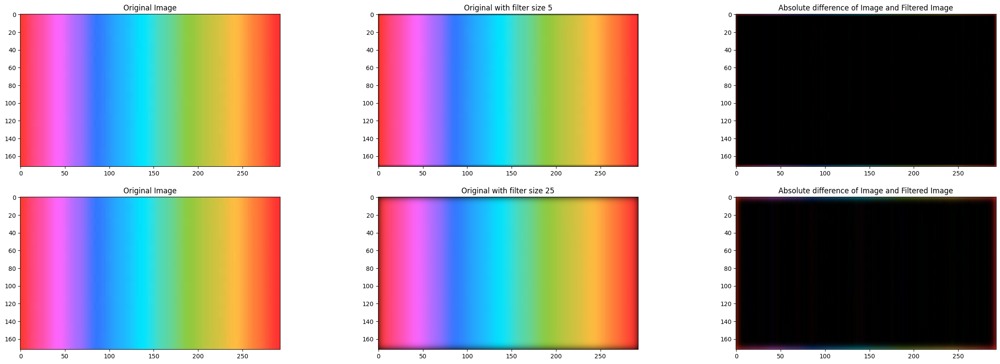

In [17]:
# Varying kernel sizes
def varying_kernel_sizes(image, sigma: int) -> None:
    fig, axes = plt.subplots(2,3,figsize=(30, 10))
    # Define Gaussian filter
    gauss_filter = gauss2D(5, sigma)
    gauss_filter_mid = gauss2D(25, sigma)

    axes[0][0].imshow(image)
    axes[0][0].set_title(f'Original Image')

    convolved_image = conv(image, gauss_filter)

    axes[0][1].imshow(convolved_image)
    axes[0][1].set_title(f'Original with filter size 5')

    axes[0][2].imshow(abs(image - convolved_image), cmap='gray')
    axes[0][2].set_title(f'Absolute difference of Image and Filtered Image')

    axes[1][0].imshow(image)
    axes[1][0].set_title(f'Original Image')

    convolved_image = conv(image, gauss_filter_mid)

    axes[1][1].imshow(convolved_image)
    axes[1][1].set_title(f'Original with filter size 25')

    axes[1][2].imshow(abs(image - convolved_image), cmap = 'gray')
    axes[1][2].set_title(f'Absolute difference of Image and Filtered Image') 
    
    plt.show()

varying_kernel_sizes(image_mandrill, 4)
varying_kernel_sizes(image_gradient, 4)

**Observations with Using Different Filters Assuming Same Sigma and Same Image**

I chose filter size 5 and 25 to compare the difference of kernels that is basically by a factor of itself since $ 5 * 5 = 25 $. It can be seen in the mandrill picture that a bigger filter size given constant image and constant sigma will result in a more blurred picture. Recall that a bigger filter size implies a larger number of neighbors that will be convolved with the pixel value and since the spread of the weights (sigma) is unchanged, this means that more pixels will be averaged out. This can be observed in the gradient picture particularly on the edges since due to zero padding, those values will influence the values meaning a larger contribution of zeroes on the edges. This can be seen by a more evident absolute difference when compare side by side. To summarize, more details will be lost due to there being a larger neighborhood of values that influence the pixel.

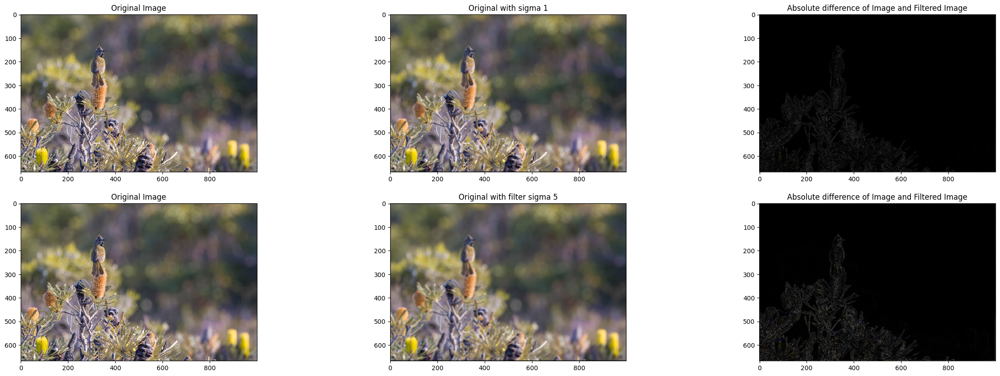

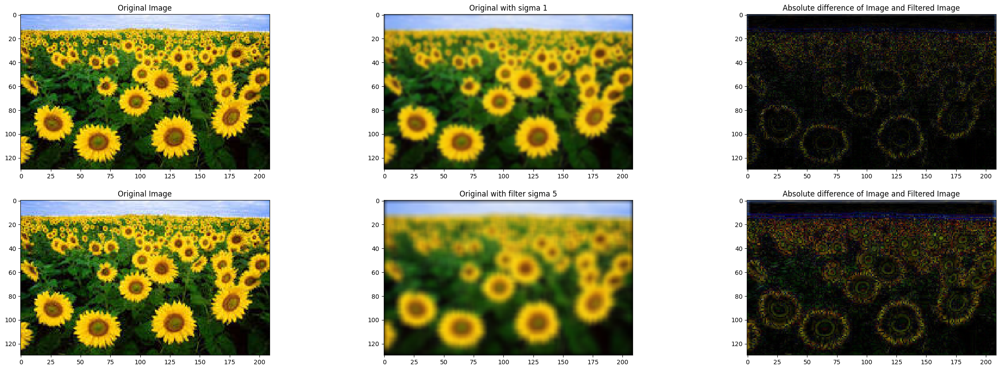

In [18]:
# Varying sigma
def varying_sigma(image) -> None:
    fig, axes = plt.subplots(2,3,figsize=(30, 10))
    # Define Gaussian filter
    gauss_filter = gauss2D(7, 1)
    gauss_filter_mid = gauss2D(7, 5)

    axes[0][0].imshow(image)
    axes[0][0].set_title(f'Original Image')

    convolved_image = conv(image, gauss_filter)

    axes[0][1].imshow(convolved_image)
    axes[0][1].set_title(f'Original with sigma 1')

    axes[0][2].imshow(abs(image - convolved_image), cmap='gray')
    axes[0][2].set_title(f'Absolute difference of Image and Filtered Image')

    axes[1][0].imshow(image)
    axes[1][0].set_title(f'Original Image')

    convolved_image = conv(image, gauss_filter_mid)

    axes[1][1].imshow(convolved_image)
    axes[1][1].set_title(f'Original with filter sigma 5')

    axes[1][2].imshow(abs(image - convolved_image), cmap = 'gray')
    axes[1][2].set_title(f'Absolute difference of Image and Filtered Image') 
    
    plt.show()

varying_sigma(image1)
varying_sigma(flower)

**Observations with Using Different Sigma (Std. Dev) Assuming Same Filter Size and Same Image**

It can be seen that a wider standard distribution will result to a more intense blur. Given the same neighborhood size provided by the kernel in both examples, a higher sigma values implies a wider distribution (or specifically higher weights), which means that the neighboring pixels will have a greater influence on the convolution of the value. This means that the pixel will be more influenced by the neighboring pixels aside from being influenced with the center (and this is primarily due to the distribution being more flat as sigma increases). It can be observed in the absolute difference that a high sigma shows brighter pixels which indicate that there is a bigger absolute difference between a bigger sigma compared to a smaller sigma.

### 3.4 Sobel filters

Define a horizontal and vertical Sobel edge filter kernel and test them on your images. You will obtain marks for testing them and displaying results in interesting ways, for example:

- apply them to an image at different scales
- considering how to display positive and negative gradients
- apply different combinations of horizontal and vertical filters

The most commonly used sobel filters are defined the following:

Horizontal Kernel ($G_x$)

$$ 
G_x = \begin{bmatrix}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1 
\end{bmatrix}
$$

Vertical Kernel ($G_y$)

$$ 
G_y = \begin{bmatrix}
1 & 2 & 1 \\
0 & 0 & 0 \\
-1 & -2 & -1 
\end{bmatrix}
$$

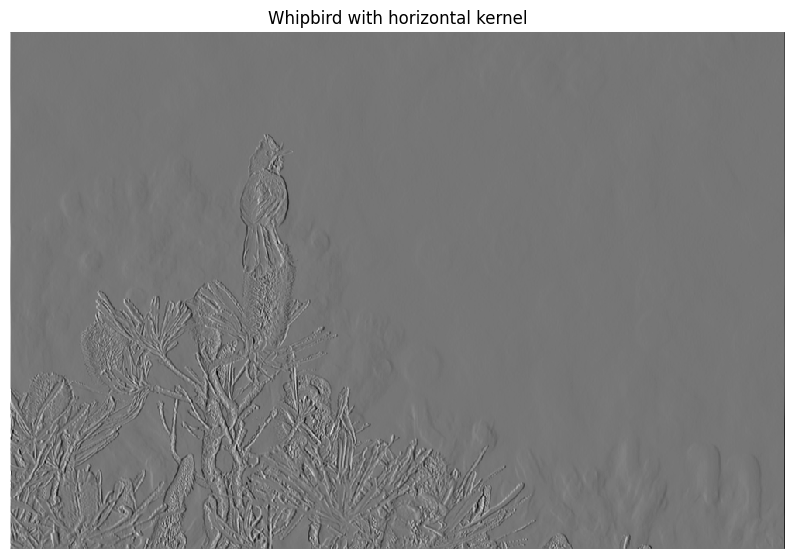

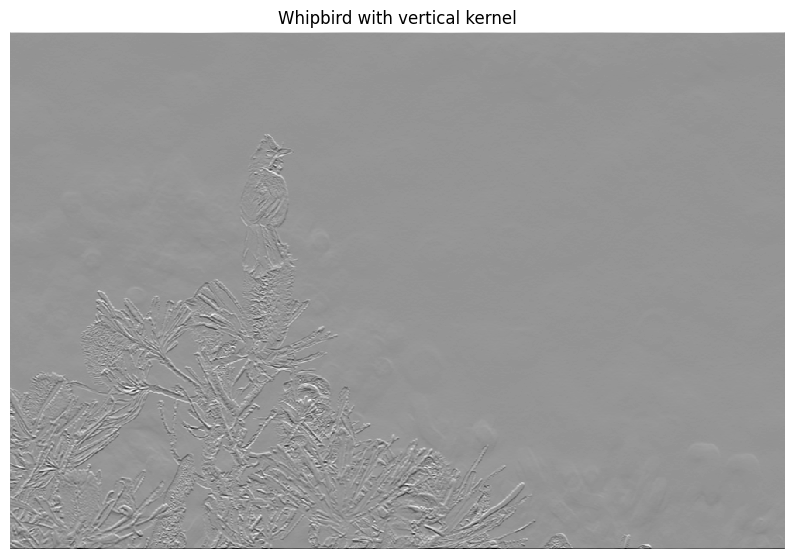

In [20]:
## define sobel operators
### Recall that the standard sobel kernel is defined as Gx and Gy
### Matrix decomposition definiton lifted from Wikipedia
horizontal_sobel = np.matmul(np.array([1,2,1]).reshape(-1,1), np.array([[1, 0, -1]]))
vertical_sobel = np.matmul(np.array([1,0,-1]).reshape(-1,1), np.array([[1, 2, 1]]))

bw_image = greyscale(image1)
whip_horizontal = conv(bw_image, horizontal_sobel)
whip_vertical = conv(bw_image, vertical_sobel)
display(whip_horizontal, caption = "Whipbird with horizontal kernel")
display(whip_vertical, caption = "Whipbird with vertical kernel")

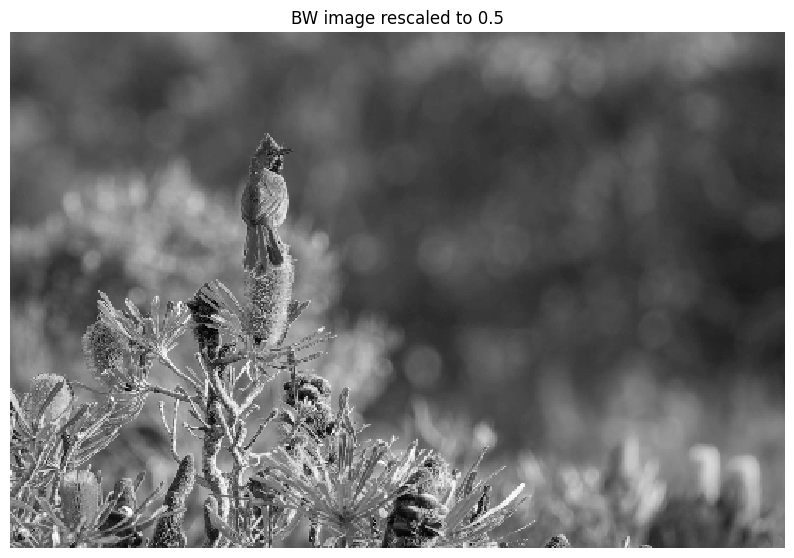

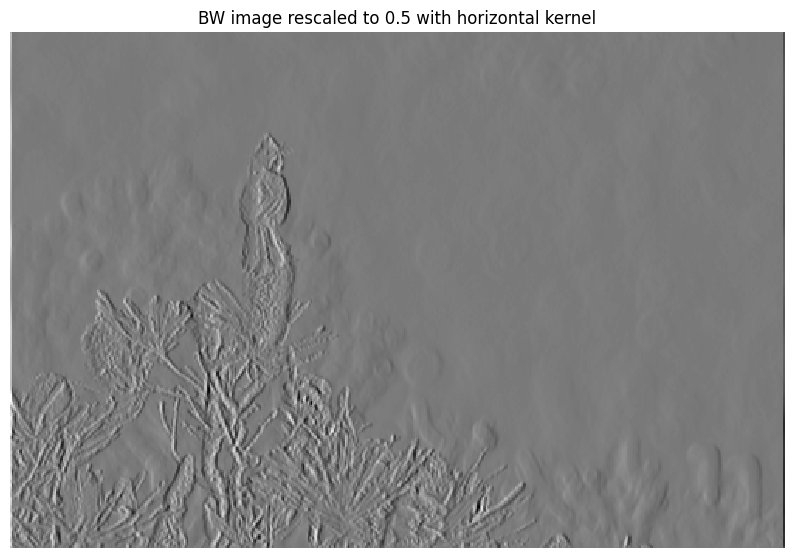

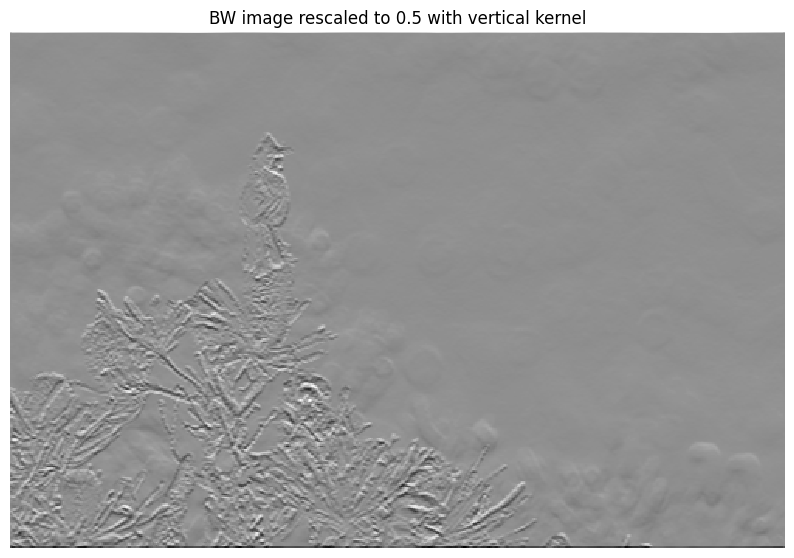

In [21]:
# Testing Sobel filter on a downsampled image
greyscale_BW = greyscale(resize(image1, 0.5, 0.5))
display(greyscale_BW, "BW image rescaled to 0.5")
display(conv(greyscale_BW, horizontal_sobel), caption = "BW image rescaled to 0.5 with horizontal kernel")
display(conv(greyscale_BW, vertical_sobel), caption = "BW image rescaled to 0.5 with vertical kernel")

Text(0.5, 1.0, 'negative_gradient of Gx')

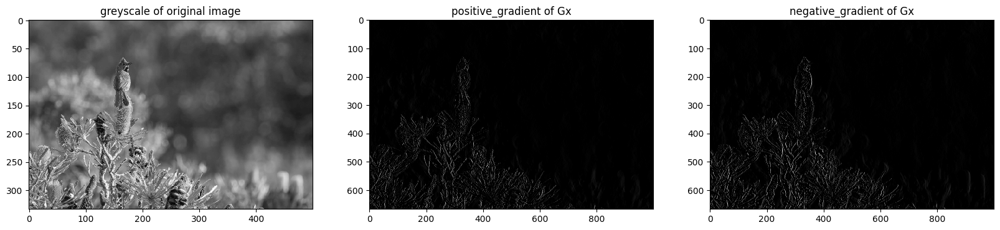

In [29]:
## From the example above we can display the positive and negative gradients
## Positive and negative on Horizontal
positive_gradient_horizontal = np.maximum(0, whip_horizontal)
# we do abs to flip the negative value into positive
negative_gradient_horizontal = abs(np.minimum(0, whip_horizontal)) 
# display(positive_gradient, caption='positive_gradient of Gx')
# display(negative_gradient, caption='negative_gradient of Gx')

fig, axes = plt.subplots(1,3,figsize=(20, 10))

axes[0].imshow(greyscale_BW)
axes[0].set_title(f'greyscale of original image')

axes[1].imshow(positive_gradient_horizontal, cmap = 'gray')
axes[1].set_title(f'positive_gradient of Gx')

axes[2].imshow(negative_gradient_horizontal, cmap = 'gray')
axes[2].set_title(f'negative_gradient of Gx')

Text(0.5, 1.0, 'negative_gradient of Gy')

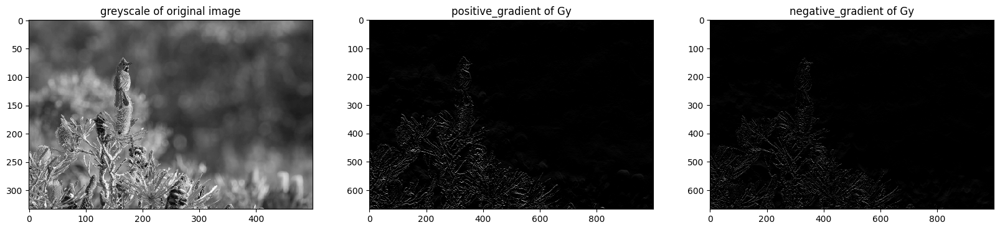

In [30]:
## From the example above we can display the positive and negative gradients
## Positive and negative on vertical
positive_gradient_vertical = np.maximum(0, whip_vertical)
# we do abs to flip the negative value into positive
negative_gradient_vertical = abs(np.minimum(0, whip_vertical)) 
# display(positive_gradient, caption='positive_gradient of Gx')
# display(negative_gradient, caption='negative_gradient of Gx')

fig, axes = plt.subplots(1,3,figsize=(20, 10))

axes[0].imshow(greyscale_BW)
axes[0].set_title(f'greyscale of original image')

axes[1].imshow(positive_gradient_vertical, cmap = 'gray')
axes[1].set_title(f'positive_gradient of Gy')

axes[2].imshow(negative_gradient_vertical, cmap = 'gray')
axes[2].set_title(f'negative_gradient of Gy')


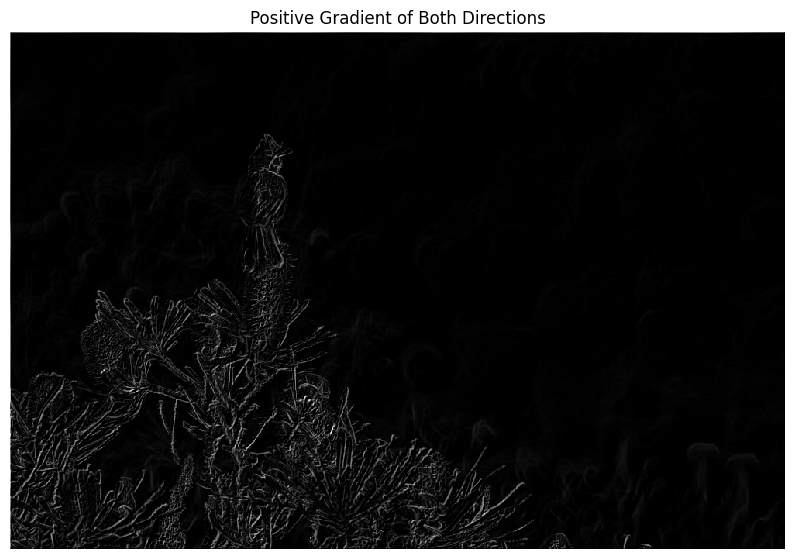

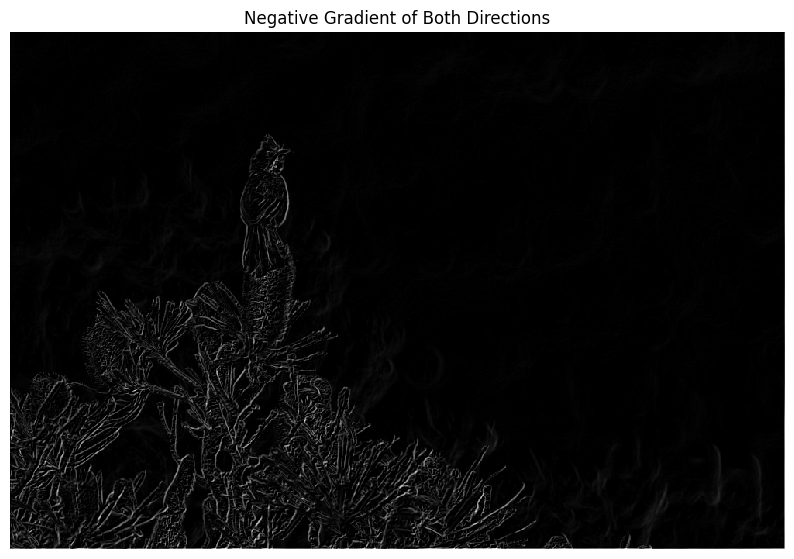

In [35]:
# combining positive gradients from both directions
positive_gradient = positive_gradient_horizontal + positive_gradient_vertical
display(positive_gradient, caption = 'Positive Gradient of Both Directions')

negative_gradient = negative_gradient_horizontal + negative_gradient_vertical
display(negative_gradient, caption = 'Negative Gradient of Both Directions')

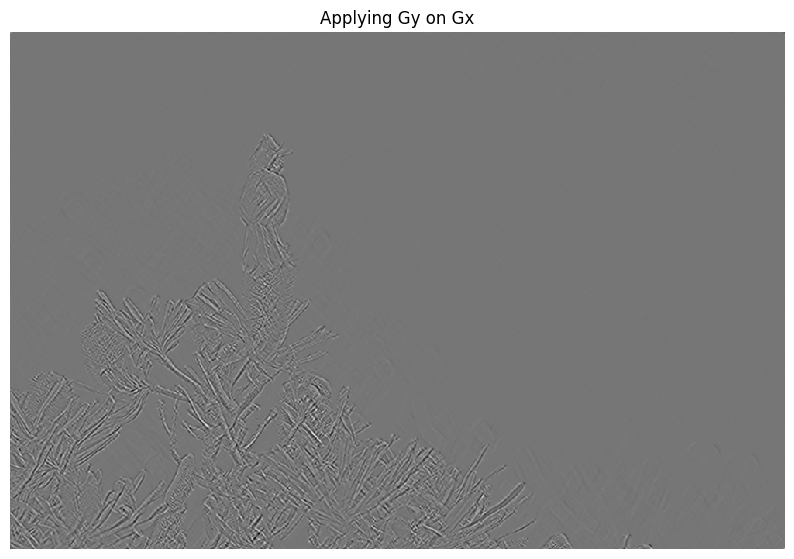

In [47]:
# applying vertical sobel on horizontal output 
display(conv(whip_horizontal, vertical_sobel), caption="Applying Gy on Gx")

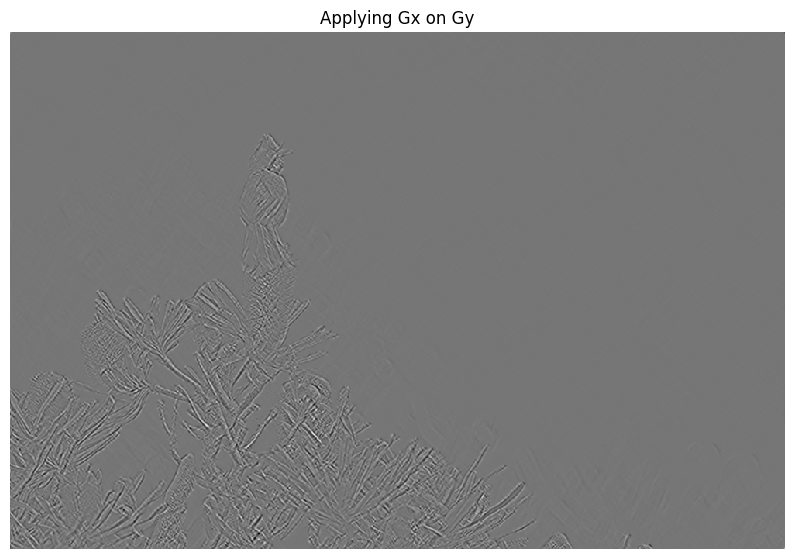

In [49]:
# applying on horizontal sobel filter on the vertical output 
display(conv(whip_vertical, horizontal_sobel), caption="Applying Gx on Gy")

## Question 4: Image sampling and pyramids (35%)

### 4.1 Image Sampling

Apply your `resize()` function to reduce an image (I) to 0.5 height and width

Repeat the above procedure, but apply a Gaussian blur filter to your original image before downsampling it. How does the result compare to your previous output, and to the original image? Why?

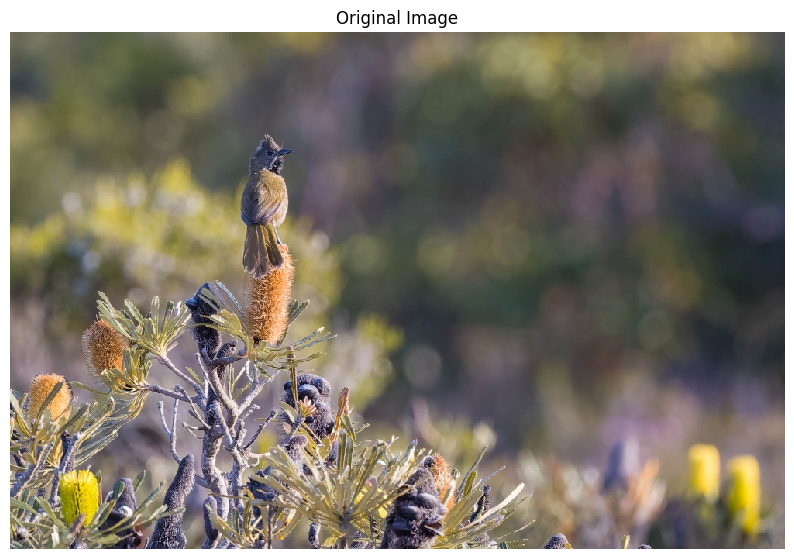

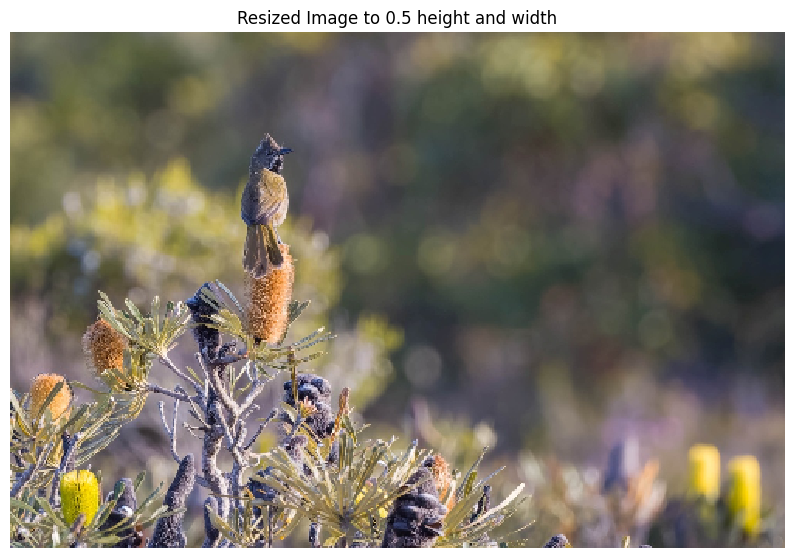

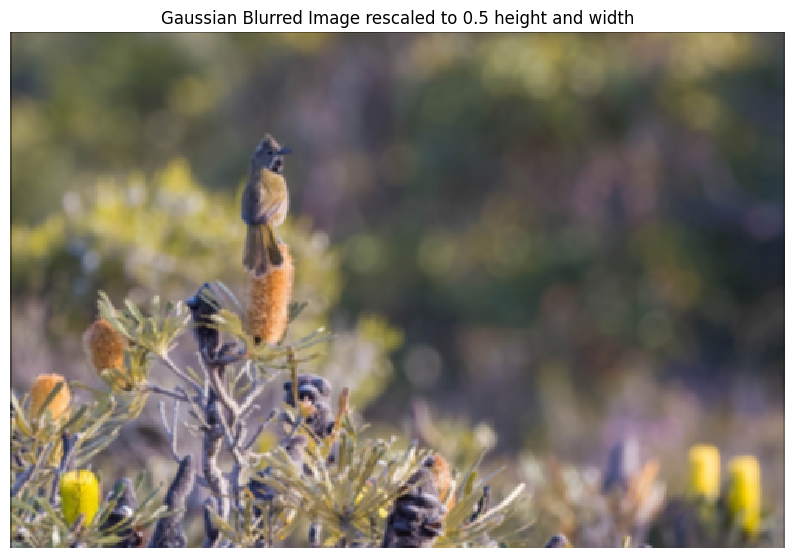

In [50]:
# Resized Image
display(image1, caption="Original Image")
display(resize(image1, 0.5, 0.5), caption = 'Resized Image to 0.5 height and width')
display(resize(conv(image1, gauss2D(5,3)), 0.5, 0.5), caption = 'Gaussian Blurred Image rescaled to 0.5 height and width')

Based from the example above, we see that the image that was blurred first appears to be smoother than the downsampled imaged which appears to be more discrete (or pixelated). The gaussian blur removes high-frequency content by effectively as a [low-pass filter](https://dsp.stackexchange.com/questions/52721/why-should-an-image-be-blurred-using-a-gaussian-kernel-before-downsampling). When an image is downsampled, high-frequecny content (areas of high contrast) can create aliasing artifcats which is the jagged parts of the image, but reducing this high-contrast with a any type of low-pass filtering can help smoothen out the image when downsampled.

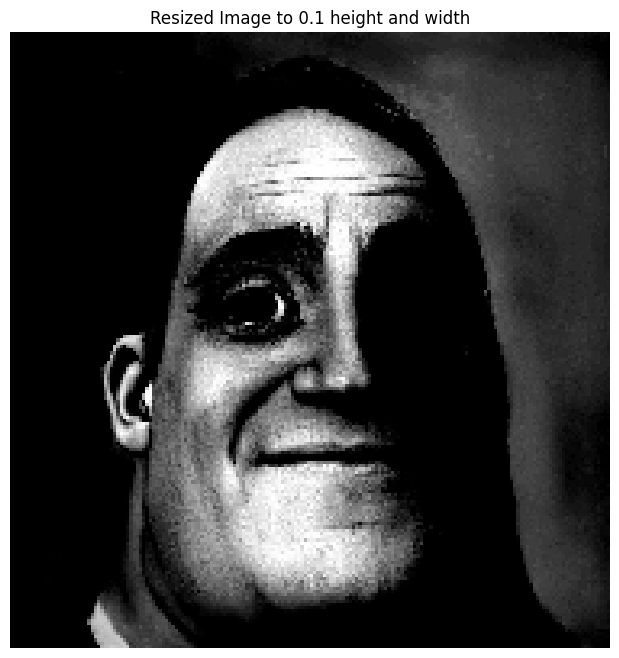

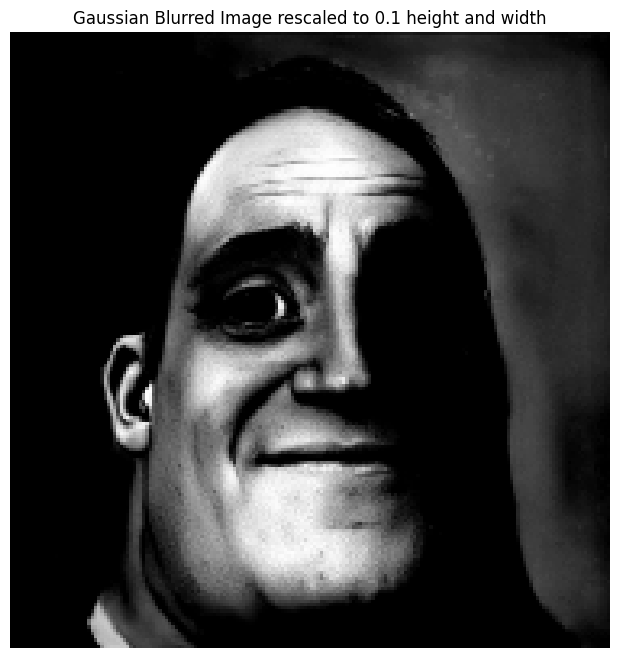

In [39]:
# Another example 
display(resize(image_BW, 0.1, 0.1), caption = 'Resized Image to 0.1 height and width')
display(resize(conv(image_BW, gauss2D(10,3)), 0.1, 0.1), caption = 'Gaussian Blurred Image rescaled to 0.1 height and width')

### 4.2 Image Pyramids 
Create a Gaussian pyramid as described in week2's lecture on an image.

Apply a Gaussian kernel to an image I, and resize it with ratio 0.5, to get $I_1$. Repeat this step to get $I_2$, $I_3$ and $I_4$.

Display these four images in a manner analogus to the example shown in the lectures.


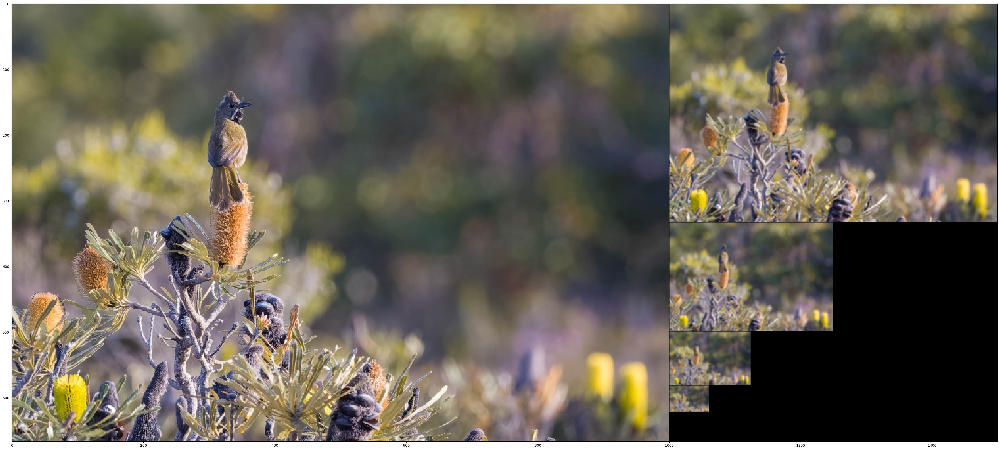

In [41]:
## 4.2 Image pyramids
# Note: Implementation is lifted from the skimage library: https://scikit-image.org/docs/stable/auto_examples/transform/plot_pyramid.html#sphx-glr-auto-examples-transform-plot-pyramid-py
# Note: The biggest image on the left is I_0: the unedited image as shown in the lecture slides in week 2 which means that there are levels + 1 images.
def gaussian_pyramid(image, kernel, ratio: float, levels: int) -> None:
    """Given an image, applies a Gaussian kernel 
        and subsamples it given a specific ratio

        Inputs:
            image: numpy array of (W, H), image array
            kernel: numpy array of (kW, kH), gaussian kernel
            ratio: float, ratio of the subsampling of image
            levels: number of times the image will be subsamples
    """
    rows, cols, dim = image.shape
    pyramid = [image]
    image_i = image
    for i in range(levels):
        image_i = conv(image_i, kernel)
        image_i = resize(image_i, ratio, ratio)
        pyramid.append(image_i)
    
    composite_rows = max(rows, sum(p.shape[0] for p in pyramid[1:]))
    composite_cols = cols + pyramid[1].shape[1]
    composite_image = np.zeros((composite_rows, composite_cols, 3), dtype=np.double)

    # store the original to the left
    composite_image[:rows, :cols, :] = pyramid[0]

    # stack all downsampled images in a column to the right of the original
    i_row = 0
    for p in pyramid[1:]:
        n_rows, n_cols = p.shape[:2]
        composite_image[i_row : i_row + n_rows, cols : cols + n_cols] = p
        i_row += n_rows

    fig, ax = plt.subplots(figsize=(50,25))
    ax.imshow(composite_image)
    plt.show()

gaussian_pyramid(image1, gauss2D(5,3), 0.5, 4)

As mentioned before, applying the Gaussian blur and then downsampling the image results in smoother image at a subsampled level of i. However, as the image scale gets progressively smaller, we notice that image is getting more and more blurred meaning more information is being lost at each level i.

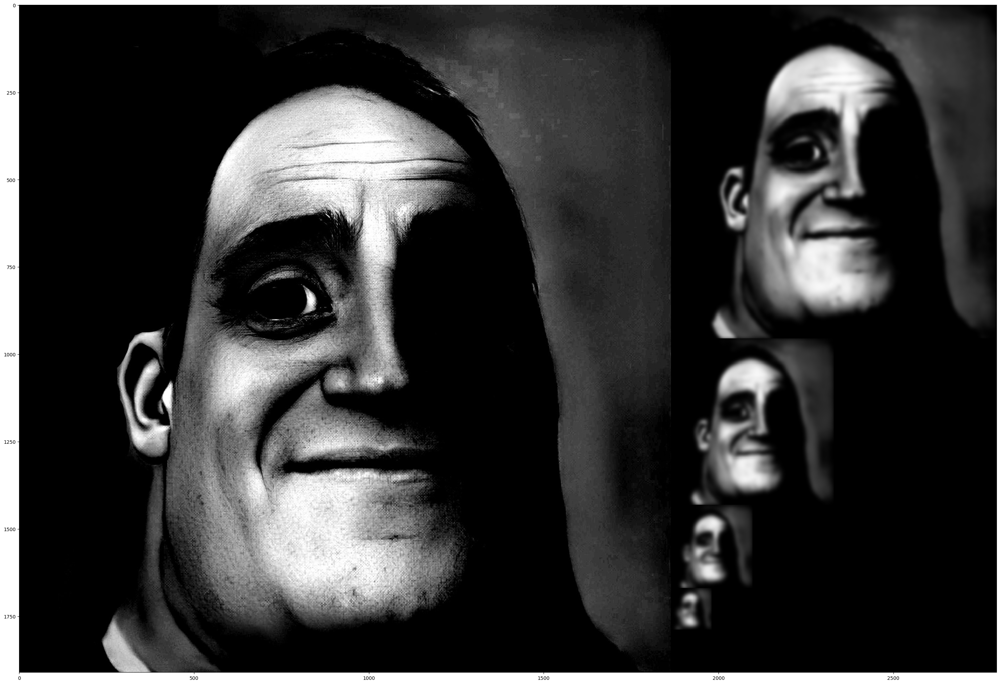

In [43]:
# Another Example
gaussian_pyramid(image_BW, gauss2D(69,10), 0.5, 4)